In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Define input and output directories
input_dir = "C:/Users/sanje/Downloads/patches"
output_dir = "C:/Users/sanje/Downloads/output_imagesdkjdbh"

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)

# Define kernel for morphological operations
kernel = np.ones((3, 3), np.uint8)
scale_factor = 0.136  # Scaling factor for measurements

# Loop through all images in the input directory
for idx, filename in enumerate(os.listdir(input_dir)):
    if filename.endswith((".png", ".jpg", ".jpeg")):
        image_path = os.path.join(input_dir, filename)
        
        # Load the **color** image
        original_image = cv2.imread(image_path)
        output_image = original_image.copy()  # Copy for visualization
        
        # Convert image to HSV color space and use the V (brightness) channel for thresholding
        hsv_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2HSV)
        v_channel = hsv_image[:, :, 2]  # Extract brightness channel
        
        # Apply **Adaptive Thresholding** on V channel
        thresh = cv2.adaptiveThreshold(v_channel, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY, 11, 2)
        
        # Apply morphological operations
        closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
        eroded_image = cv2.erode(closed, kernel, iterations=1)
        blurred = cv2.GaussianBlur(eroded_image, (7, 7), 0)

        # Find contours
        contours, hierarchy = cv2.findContours(blurred, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

        if hierarchy is None:  # No contours found, skip image
            print(f"Skipping {filename}: No contours detected.")
            continue

        rbc = 0  # RBC counter
        min_contour_area = 620  # Filter out small contours
        object_counter = 1
        radii_data = []
        num_outer_contours = 0

        # Process contours
        for i, contour in enumerate(contours):
            if cv2.contourArea(contour) < min_contour_area:
                continue

            if hierarchy[0][i][3] == -1:  # Outer boundary
                (x_outer, y_outer), outer_radius = cv2.minEnclosingCircle(contour)
                cv2.drawContours(output_image, [contour], -1, (255, 0, 0), 2)  # Blue for outer
                cv2.putText(output_image, f"Obj {object_counter}", (int(x_outer)-10, int(y_outer)-20),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1)

                # Find the largest inner contour
                inner_radius = 0
                largest_inner_contour = None
                max_area = 0

                for j, child_contour in enumerate(contours):
                    if hierarchy[0][j][3] == i:
                        area = cv2.contourArea(child_contour)
                        if area > max_area:
                            max_area = area
                            largest_inner_contour = child_contour
                            (x_inner, y_inner), inner_radius = cv2.minEnclosingCircle(child_contour)

                if largest_inner_contour is not None:
                    cv2.drawContours(output_image, [largest_inner_contour], -1, (0, 255, 0), 2)
                    cv2.putText(output_image, f"Obj {object_counter}", (int(x_inner) - 10, int(y_inner) - 20),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1)

                else:
                    x, y, w, h = cv2.boundingRect(contour)
                    cv2.drawContours(output_image, [contour], -1, (0, 255, 0), 2)
                    cv2.putText(output_image, "RBC", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
                    rbc += 1

                thickness = outer_radius - inner_radius
                diameter = 2 * outer_radius
                radii_data.append({
                    "axon_id": object_counter,
                    "outer_radius": outer_radius * scale_factor,
                    "inner_radius": inner_radius * scale_factor,
                    "thickness": thickness * scale_factor,
                    "diameter": diameter * scale_factor,
                    "center": (x_outer, y_outer)
                })

                object_counter += 1

        # Avoid division by zero
        percentage = (rbc / object_counter) * 100 if object_counter > 0 else 0
        category = "rbc" if percentage > 70 else "direct"

        # Save results
        save_path = os.path.join(output_dir, f"output_image_{idx}.png")
        cv2.imwrite(save_path, output_image)

        # Display results
        fig, axes = plt.subplots(1, 3, figsize=(12, 8))
        axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))  # Show original color image
        axes[0].set_title("Input Image")
        axes[0].axis('off')

        axes[1].imshow(blurred, cmap='gray')
        axes[1].set_title("Blurred Thresholded Image")
        axes[1].axis('off')

        axes[2].imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))  # Show output with contours
        axes[2].set_title("Output Image with Contours")
        axes[2].axis('off')

        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f"result_{idx}.png"), dpi=300)
        plt.close()

        # Print measurements
        for axon_data in radii_data:
            print(f"Image {filename}, Object {axon_data['axon_id']}:")
            print(f"  Center = {axon_data['center'][0]:.2f}, {axon_data['center'][1]:.2f}")
            print(f"  Outer Radius = {axon_data['outer_radius']:.4f} micro meters")
            print(f"  Diameter = {axon_data['diameter']:.4f} micro meters")
            print(f"  Inner Radius = {axon_data['inner_radius']:.4f} micro meters")
            print(f"  Thickness = {axon_data['thickness']:.4f} micro meters\n")

print(f"Processing complete. Results saved in {output_dir}")
# output


Image systematic_patch_1.png, Object 1:
  Center = 255.50, 255.50
  Outer Radius = 49.1411 micro meters
  Diameter = 98.2822 micro meters
  Inner Radius = 2.5849 micro meters
  Thickness = 46.5562 micro meters

Image systematic_patch_10.png, Object 1:
  Center = 255.50, 255.50
  Outer Radius = 49.1411 micro meters
  Diameter = 98.2822 micro meters
  Inner Radius = 2.4631 micro meters
  Thickness = 46.6780 micro meters

Image systematic_patch_11.png, Object 1:
  Center = 255.50, 255.50
  Outer Radius = 49.1411 micro meters
  Diameter = 98.2822 micro meters
  Inner Radius = 0.9123 micro meters
  Thickness = 48.2288 micro meters

Image systematic_patch_12.png, Object 1:
  Center = 255.50, 255.50
  Outer Radius = 49.1411 micro meters
  Diameter = 98.2822 micro meters
  Inner Radius = 3.0411 micro meters
  Thickness = 46.1000 micro meters

Image systematic_patch_13.png, Object 1:
  Center = 255.50, 255.50
  Outer Radius = 49.1411 micro meters
  Diameter = 98.2822 micro meters
  Inner Radius

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Define input and output directories
input_dir = "C:/Users/sanje/Downloads/patches"
output_dir = "C:/Users/sanje/Downloads/output_imagessn"

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)

# Define kernel for morphological operations
kernel = np.ones((3, 3), np.uint8)
scale_factor = 0.136  # Scaling factor for measurements

# Loop through all images in the input directory
for idx, filename in enumerate(os.listdir(input_dir)):
    if filename.endswith((".png", ".jpg", ".jpeg")):
        image_path = os.path.join(input_dir, filename)
        
        # Load the **color** image
        original_image = cv2.imread(image_path)

        # Convert the color image to HSV for better thresholding (keeping color)
        hsv_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2HSV)
        
        # Define threshold ranges (tune these for better results)
        lower_bound = np.array([0, 25, 40])  # Example values, adjust as needed
        upper_bound = np.array([139, 255, 255])

        # Create a binary mask based on the threshold
        thresh = cv2.inRange(hsv_image, lower_bound, upper_bound)

        # Apply morphological operations
        closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
        eroded_image = cv2.erode(closed, kernel, iterations=1)
        blurred = cv2.GaussianBlur(eroded_image, (7, 7), 0)

        # Find contours
        contours, hierarchy = cv2.findContours(blurred, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

        if hierarchy is None:  # No contours found, skip image
            print(f"Skipping {filename}: No contours detected.")
            continue

        rbc = 0  # RBC counter
        min_contour_area = 520  # Filter out small contours
        object_counter = 1
        radii_data = []
        num_outer_contours = 0

        # Create a copy of the **original color image** for visualization
        output_image = original_image.copy()

        # Process contours
        for i, contour in enumerate(contours):
            if cv2.contourArea(contour) < min_contour_area:
                continue

            if hierarchy[0][i][3] == -1:  # Outer boundary
                (x_outer, y_outer), outer_radius = cv2.minEnclosingCircle(contour)
                cv2.drawContours(output_image, [contour], -1, (255, 0, 0), 2)  # Blue for outer
                cv2.putText(output_image, f"Obj {object_counter}", (int(x_outer)-10, int(y_outer)-20),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1)

                # Find the largest inner contour
                inner_radius = 0
                largest_inner_contour = None
                max_area = 0

                for j, child_contour in enumerate(contours):
                    if hierarchy[0][j][3] == i:
                        area = cv2.contourArea(child_contour)
                        if area > max_area:
                            max_area = area
                            largest_inner_contour = child_contour
                            (x_inner, y_inner), inner_radius = cv2.minEnclosingCircle(child_contour)

                if largest_inner_contour is not None:
                    cv2.drawContours(output_image, [largest_inner_contour], -1, (0, 255, 0), 2)
                    cv2.putText(output_image, f"Obj {object_counter}", (int(x_inner) - 10, int(y_inner) - 20),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1)

                else:
                    x, y, w, h = cv2.boundingRect(contour)
                    cv2.drawContours(output_image, [contour], -1, (0, 255, 0), 2)
                    cv2.putText(output_image, "RBC", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
                    rbc += 1

                thickness = outer_radius - inner_radius
                diameter = 2 * outer_radius
                radii_data.append({
                    "axon_id": object_counter,
                    "outer_radius": outer_radius * scale_factor,
                    "inner_radius": inner_radius * scale_factor,
                    "thickness": thickness * scale_factor,
                    "diameter": diameter * scale_factor,
                    "center": (x_outer, y_outer)
                })

                object_counter += 1

        # Avoid division by zero
        percentage = (rbc / object_counter) * 100 if object_counter > 0 else 0
        category = "rbc" if percentage > 70 else "direct"

        # Save results
        save_path = os.path.join(output_dir, f"output_image_{idx}.png")
        cv2.imwrite(save_path, output_image)

        # Display results
        fig, axes = plt.subplots(1, 3, figsize=(12, 8))
        axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))  # Show original color image
        axes[0].set_title("Input Image")
        axes[0].axis('off')

        axes[1].imshow(blurred, cmap='gray')
        axes[1].set_title("Blur Thresholded Image")
        axes[1].axis('off')

        axes[2].imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))  # Show output with contours
        axes[2].set_title("Output Image with Contours")
        axes[2].axis('off')

        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f"result_{idx}.png"), dpi=300)
        plt.close()

        # Print measurements
        for axon_data in radii_data:
            print(f"Image {filename}, Object {axon_data['axon_id']}:")
            print(f"  Center = {axon_data['center'][0]:.2f}, {axon_data['center'][1]:.2f}")
            print(f"  Outer Radius = {axon_data['outer_radius']:.4f} micro meters")
            print(f"  Diameter = {axon_data['diameter']:.4f} micro meters")
            print(f"  Inner Radius = {axon_data['inner_radius']:.4f} micro meters")
            print(f"  Thickness = {axon_data['thickness']:.4f} micro meters\n")

print(f"Processing complete. Results saved in {output_dir}")


Image systematic_patch_1.png, Object 1:
  Center = 211.00, 312.00
  Outer Radius = 3.2697 micro meters
  Diameter = 6.5394 micro meters
  Inner Radius = 0.0000 micro meters
  Thickness = 3.2697 micro meters

Image systematic_patch_1.png, Object 2:
  Center = 133.47, 320.33
  Outer Radius = 7.4773 micro meters
  Diameter = 14.9547 micro meters
  Inner Radius = 0.0000 micro meters
  Thickness = 7.4773 micro meters

Image systematic_patch_1.png, Object 3:
  Center = 216.00, 164.50
  Outer Radius = 4.2883 micro meters
  Diameter = 8.5767 micro meters
  Inner Radius = 0.1360 micro meters
  Thickness = 4.1523 micro meters

Image systematic_patch_1.png, Object 4:
  Center = 336.50, 154.50
  Outer Radius = 5.5285 micro meters
  Diameter = 11.0571 micro meters
  Inner Radius = 0.0000 micro meters
  Thickness = 5.5285 micro meters

Image systematic_patch_1.png, Object 5:
  Center = 260.50, 123.50
  Outer Radius = 6.5851 micro meters
  Diameter = 13.1703 micro meters
  Inner Radius = 0.0000 micro

107
90.625
Subplots saved to results/rbc _ 1
Object 1:
  Center = 219.00 , 496.93
  Outer Radius = 2.8978 micro meters
  Diameter = 5.7956 micro meters
  Inner Radius = 0.0000 micro meters
  Thickness = 2.8978 micro meters

Object 2:
  Center = 231.50 , 441.50
  Outer Radius = 2.6459 micro meters
  Diameter = 5.2918 micro meters
  Inner Radius = 0.0000 micro meters
  Thickness = 2.6459 micro meters

Object 3:
  Center = 382.45 , 384.28
  Outer Radius = 1.8962 micro meters
  Diameter = 3.7924 micro meters
  Inner Radius = 0.0000 micro meters
  Thickness = 1.8962 micro meters

Object 4:
  Center = 343.00 , 382.50
  Outer Radius = 2.0092 micro meters
  Diameter = 4.0184 micro meters
  Inner Radius = 0.0000 micro meters
  Thickness = 2.0092 micro meters

Object 5:
  Center = 15.00 , 375.50
  Outer Radius = 3.6777 micro meters
  Diameter = 7.3554 micro meters
  Inner Radius = 0.0000 micro meters
  Thickness = 3.6777 micro meters

Object 6:
  Center = 318.00 , 367.50
  Outer Radius = 2.3130 

C:\Users\sanje\AppData\Local\Temp\ipykernel_21996\2861794929.py:91: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 3, figsize=(12, 8))


Subplots saved to results/direct _ 21
Object 1:
  Center = 287.50 , 500.00
  Outer Radius = 4.2819 micro meters
  Diameter = 8.5637 micro meters
  Inner Radius = 0.6451 micro meters
  Thickness = 3.6367 micro meters

Object 2:
  Center = 61.65 , 458.76
  Outer Radius = 2.2856 micro meters
  Diameter = 4.5713 micro meters
  Inner Radius = 0.1360 micro meters
  Thickness = 2.1496 micro meters

Object 3:
  Center = 480.00 , 437.00
  Outer Radius = 2.3160 micro meters
  Diameter = 4.6320 micro meters
  Inner Radius = 0.0000 micro meters
  Thickness = 2.3160 micro meters

Object 4:
  Center = 27.50 , 402.00
  Outer Radius = 2.1342 micro meters
  Diameter = 4.2683 micro meters
  Inner Radius = 0.6451 micro meters
  Thickness = 1.4891 micro meters

Object 5:
  Center = 470.00 , 384.50
  Outer Radius = 3.3153 micro meters
  Diameter = 6.6306 micro meters
  Inner Radius = 0.9249 micro meters
  Thickness = 2.3904 micro meters

Object 6:
  Center = 132.50 , 340.50
  Outer Radius = 3.1324 micro me

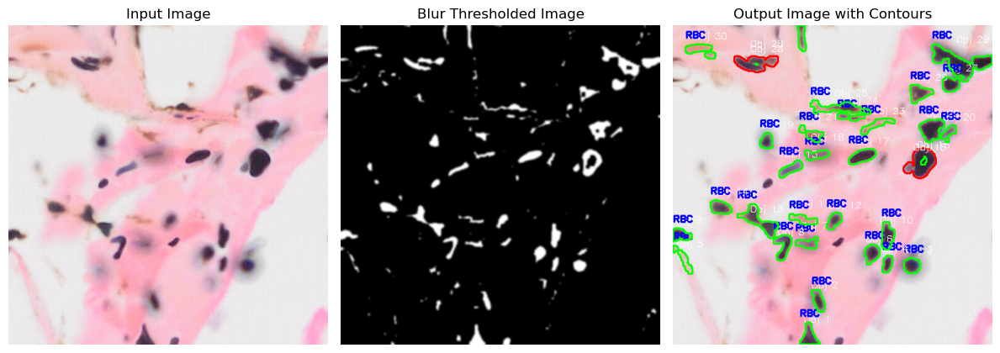

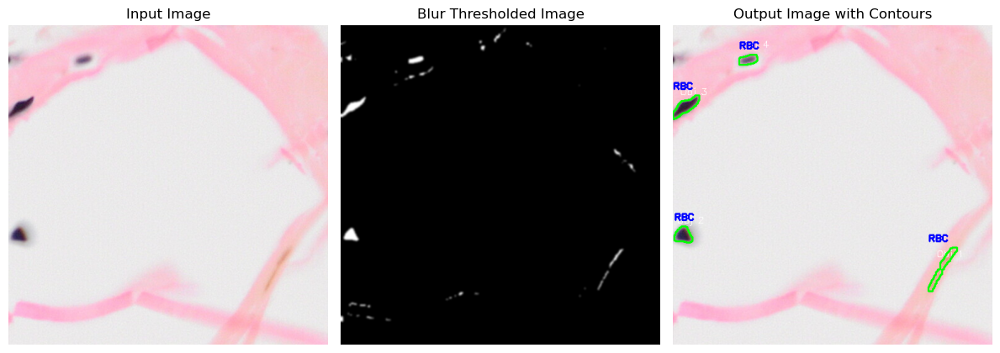

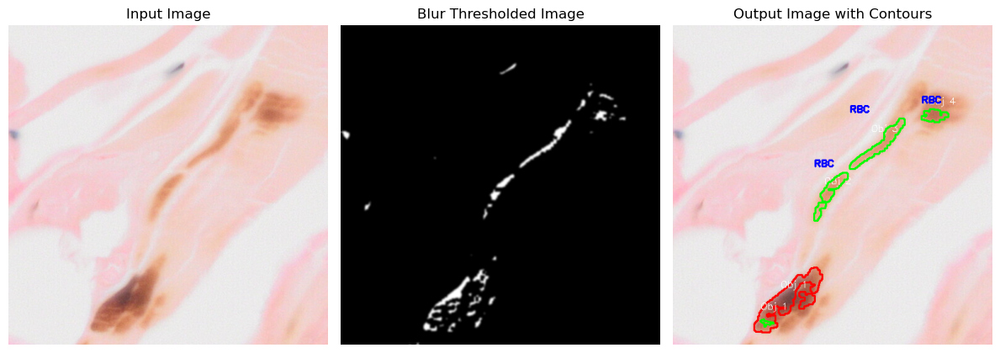

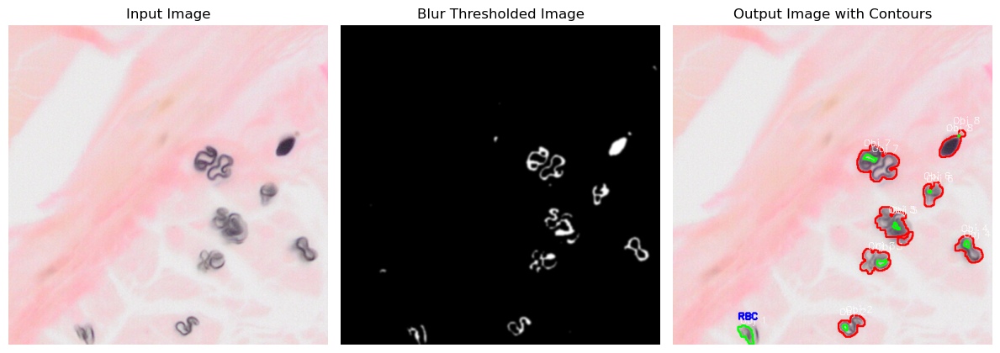

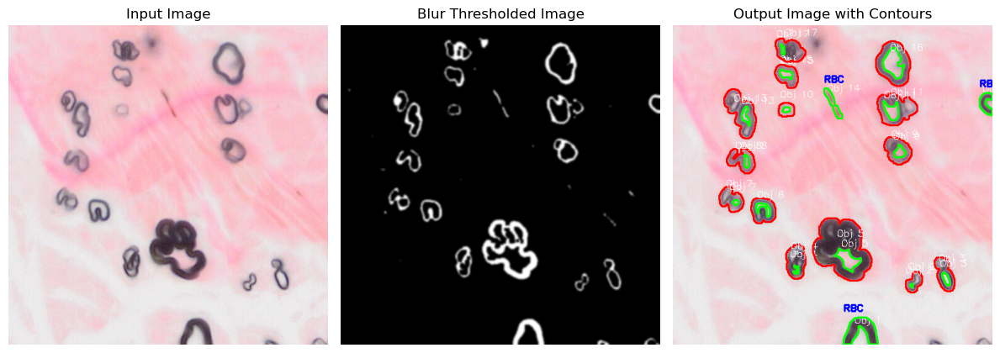

...

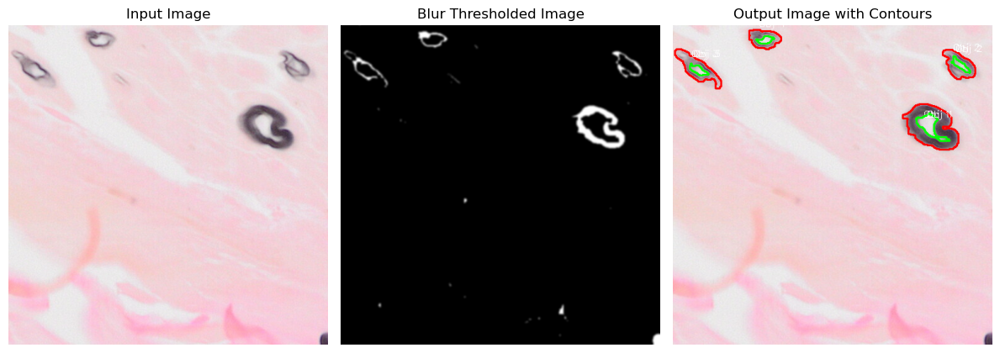

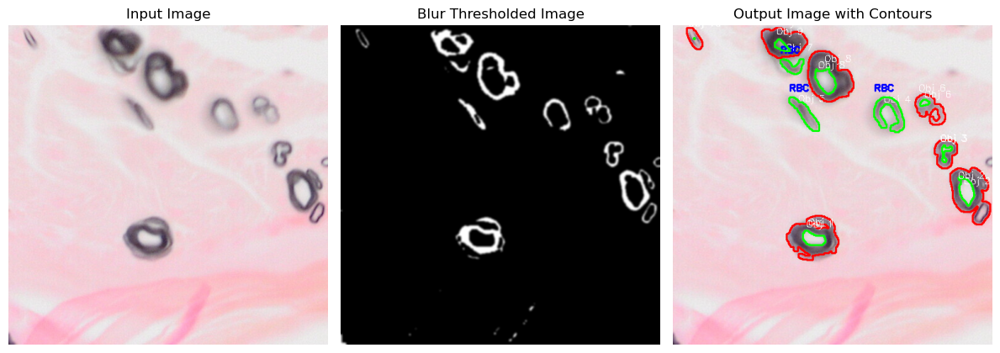

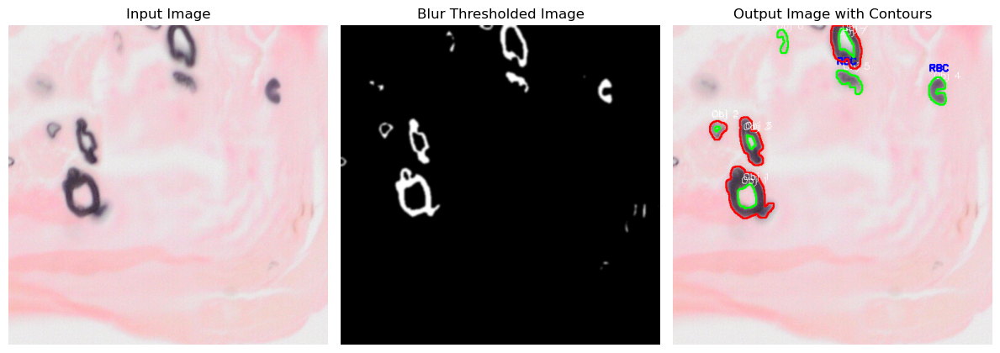

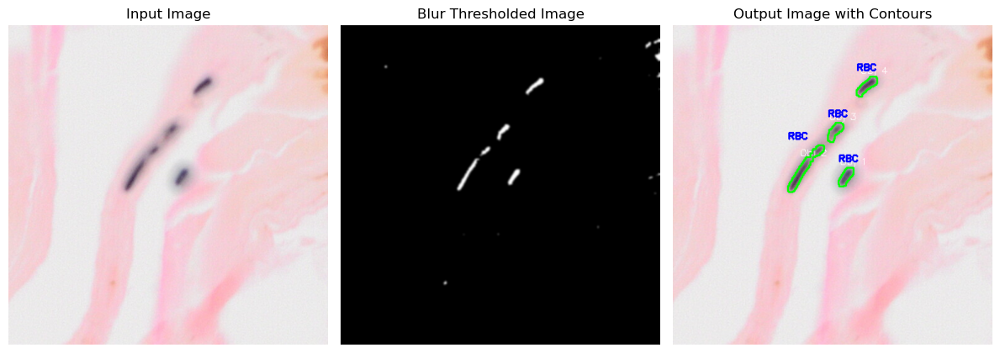

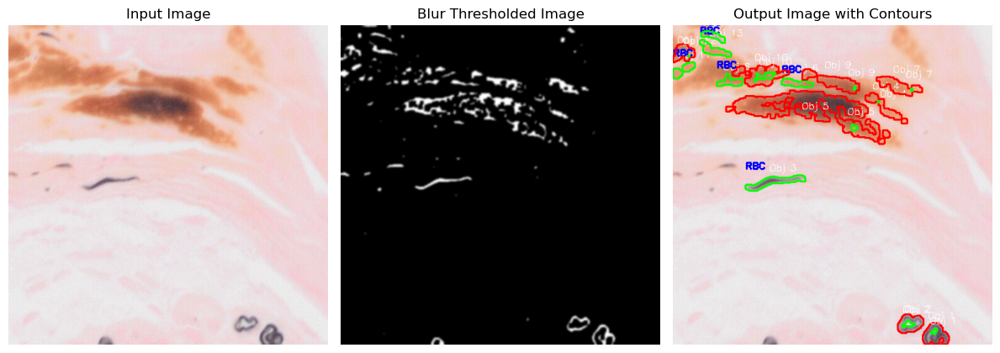

In [20]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import os

for num in range(1, 82):
    file_path = fr"C:\Users\sanje\Downloads\patches\systematic_patch_{num}.png"
    
    # Check if file exists before opening
    if not os.path.exists(file_path):
        print(f"File not found: {file_path}")
        continue  # Skip this iteration if the file is missing

    patch1 = Image.open(file_path)
    patch_np = np.array(patch1)
    patch_bgr = cv2.cvtColor(patch_np, cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(patch_bgr, cv2.COLOR_BGR2GRAY)
    x_ticks = np.arange(0, 513, 20)
    y_ticks = np.arange(0, 513, 20)

    _, thresholded = cv2.threshold(gray, 140, 255, cv2.THRESH_BINARY_INV)
    thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 27, 6)

    kernel = np.ones((3, 3), np.uint8)
    closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
    eroded_image = cv2.erode(closed, kernel, iterations=1)
    blurred = cv2.GaussianBlur(eroded_image, (7, 7), 0)

    contours, hierarchy = cv2.findContours(blurred, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    print(len(contours))

    output_image_bw = patch_np
    min_contour_area = 320
    object_counter = 1
    radii_data = []
    rbc = 0
    directory_name = "direct"

    for i, contour in enumerate(contours):
        if cv2.contourArea(contour) < min_contour_area:
            continue

        if hierarchy[0][i][3] == -1:
            (x_outer, y_outer), outer_radius = cv2.minEnclosingCircle(contour)
            cv2.drawContours(output_image_bw, [contour], -1, (255, 0, 0), 2)
            cv2.putText(output_image_bw, f"Obj {object_counter}", (int(x_outer) - 10, int(y_outer) - 20),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)

            inner_radius = 0
            largest_inner_contour = None
            max_area = 0
            inner_radius = 0

            for j, child_contour in enumerate(contours):
                if hierarchy[0][j][3] == i:
                    area = cv2.contourArea(child_contour)
                    if area > max_area:
                        max_area = area
                        largest_inner_contour = child_contour
                        (x_inner, y_inner), inner_radius = cv2.minEnclosingCircle(child_contour)

            if largest_inner_contour is not None:
                cv2.drawContours(output_image_bw, [largest_inner_contour], -1, (0, 255, 0), 2)
                cv2.putText(output_image_bw, f"Obj {object_counter}", (int(x_inner) - 10, int(y_inner) - 20),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)
            else:
                x, y, w, h = cv2.boundingRect(contour)
                cv2.drawContours(output_image_bw, [contour], -1, (0, 255, 0), 2)
                cv2.putText(output_image_bw, "RBC", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
                rbc += 1

            thickness = outer_radius - inner_radius
            scale_factor = 0.136
            diameter = 2 * outer_radius
            radii_data.append({
                "axon_id": object_counter,
                "outer_radius": outer_radius * scale_factor,
                "inner_radius": inner_radius * scale_factor,
                "thickness": thickness * scale_factor,
                "diameter": diameter*scale_factor,
                "center": (x_outer, y_outer)
            })
            object_counter += 1

    percentage = (rbc / object_counter) * 100
    if percentage > 55:
        directory_name = "rbc"
    print(percentage)

    fig, axes = plt.subplots(1, 3, figsize=(12, 8))
    axes[0].imshow(patch1, cmap='gray')
    axes[0].set_title("Input Image")
    axes[0].axis('off')
    axes[1].imshow(blurred, cmap='gray')
    axes[1].set_title("Blur Thresholded Image")
    axes[1].axis('off')
    axes[2].imshow(output_image_bw)
    axes[2].set_title("Output Image with Contours")
    axes[2].axis('off')

    plt.tight_layout()
    output_dir = "results/" + directory_name
    output_dir = f'results/{directory_name}'
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    plt.savefig(f'{output_dir}/output_image_dir_{num}', dpi=300)
    print(f"Subplots saved to {output_dir} _ {num}")

    for axon_data in radii_data:
        obj_id = axon_data["axon_id"]
        center = axon_data["center"]
        outer_radius = axon_data["outer_radius"]
        inner_radius = axon_data["inner_radius"]
        thickness = axon_data["thickness"]
        diameter = axon_data["diameter"]
        
        print(f"Object {obj_id}:")
        print(f"  Center = {center[0]:.2f} , {center[1]:.2f}")
        print(f"  Outer Radius = {outer_radius:.4f} micro meters")
        print(f"  Diameter = {diameter:.4f} micro meters")
        print(f"  Inner Radius = {inner_radius:.4f} micro meters")
        print(f"  Thickness = {thickness:.4f} micro meters\n")

Processed systematic_patch_1.png - Axons detected: 30

Axon 1:
  Center = (456.00, 62.00)
  Outer Radius = 0.6257 µm
  Inner Radius = 0.6257 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (456.00, 62.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (456.00, 62.00)
  Outer Radius = 1.2270 µm
  Inner Radius = 1.2270 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (456.00, 62.00)
  Outer Radius = 1.3013 µm
  Inner Radius = 1.3013 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (456.00, 62.00)
  Outer Radius = 0.2985 µm
  Inner Radius = 0.2985 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (456.00, 62.00)
  Outer Radius = 0.8983 µm
  Inner Radius = 0.8983 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (456.00, 62.00)
  Outer Radius = 1.6831 µm
  Inner Radius = 1.6831 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (456.00, 62.00)
  Outer Radius = 1.2463 µm
  Inner Radius = 1.2463 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (456.00, 62.00

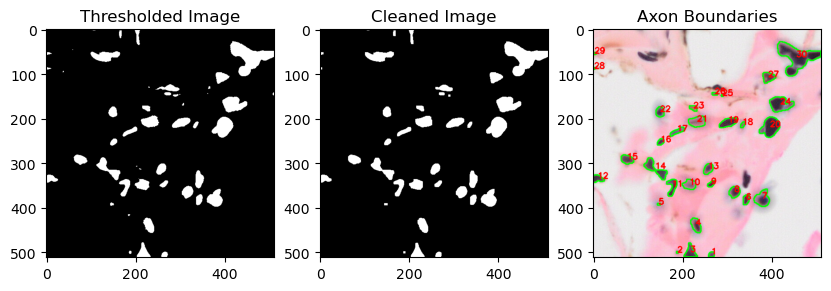

Processed systematic_patch_10.png - Axons detected: 22

Axon 1:
  Center = (221.00, 9.00)
  Outer Radius = 1.2482 µm
  Inner Radius = 1.2482 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (221.00, 9.00)
  Outer Radius = 1.0249 µm
  Inner Radius = 1.0249 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (221.00, 9.00)
  Outer Radius = 0.4496 µm
  Inner Radius = 0.4496 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (221.00, 9.00)
  Outer Radius = 1.7970 µm
  Inner Radius = 1.7970 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (221.00, 9.00)
  Outer Radius = 0.5337 µm
  Inner Radius = 0.5337 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (221.00, 9.00)
  Outer Radius = 1.1156 µm
  Inner Radius = 1.1156 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (221.00, 9.00)
  Outer Radius = 1.7122 µm
  Inner Radius = 1.7122 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (221.00, 9.00)
  Outer Radius = 1.0600 µm
  Inner Radius = 1.0600 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (221.00, 9.00)
  Oute

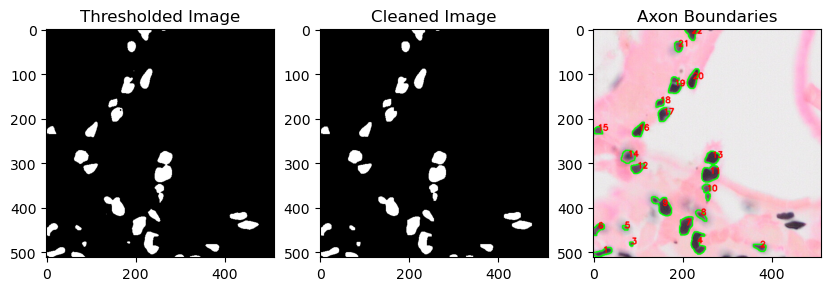

Processed systematic_patch_11.png - Axons detected: 5

Axon 1:
  Center = (467.00, 172.00)
  Outer Radius = 3.9143 µm
  Inner Radius = 3.9143 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (467.00, 172.00)
  Outer Radius = 5.6831 µm
  Inner Radius = 5.6831 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (467.00, 172.00)
  Outer Radius = 0.2764 µm
  Inner Radius = 0.2764 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (467.00, 172.00)
  Outer Radius = 2.4927 µm
  Inner Radius = 2.4927 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (467.00, 172.00)
  Outer Radius = 4.3532 µm
  Inner Radius = 4.3532 µm
  Thickness = 0.0000 µm



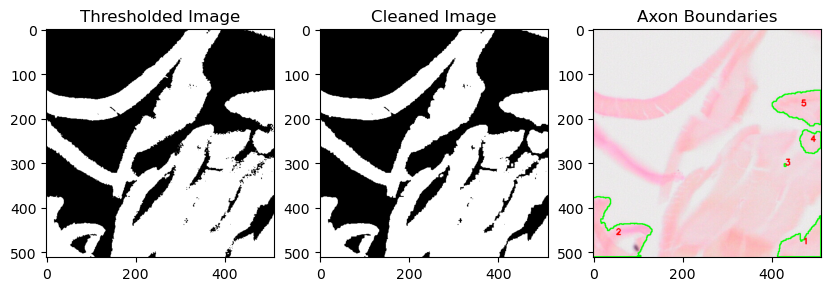

Processed systematic_patch_12.png - Axons detected: 9

Axon 1:
  Center = (116.00, 7.00)
  Outer Radius = 0.4406 µm
  Inner Radius = 0.4406 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (116.00, 7.00)
  Outer Radius = 2.1197 µm
  Inner Radius = 2.1197 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (116.00, 7.00)
  Outer Radius = 1.9049 µm
  Inner Radius = 1.9049 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (116.00, 7.00)
  Outer Radius = 2.1465 µm
  Inner Radius = 2.1465 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (116.00, 7.00)
  Outer Radius = 2.1432 µm
  Inner Radius = 2.1432 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (116.00, 7.00)
  Outer Radius = 3.4934 µm
  Inner Radius = 3.4934 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (116.00, 7.00)
  Outer Radius = 1.7362 µm
  Inner Radius = 1.7362 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (116.00, 7.00)
  Outer Radius = 0.8930 µm
  Inner Radius = 0.8930 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (116.00, 7.00)
  Outer

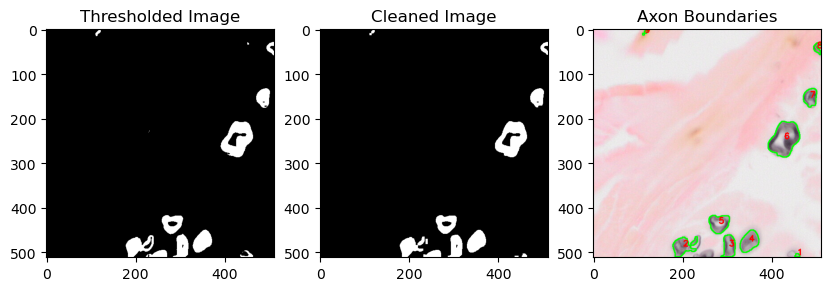

Processed systematic_patch_13.png - Axons detected: 16

Axon 1:
  Center = (404.00, 57.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (404.00, 57.00)
  Outer Radius = 0.9491 µm
  Inner Radius = 0.9491 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (404.00, 57.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (404.00, 57.00)
  Outer Radius = 1.3906 µm
  Inner Radius = 1.3906 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (404.00, 57.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (404.00, 57.00)
  Outer Radius = 0.4370 µm
  Inner Radius = 0.4370 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (404.00, 57.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (404.00, 57.00)
  Outer Radius = 0.7807 µm
  Inner Radius = 0.7807 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (404.00, 57.0

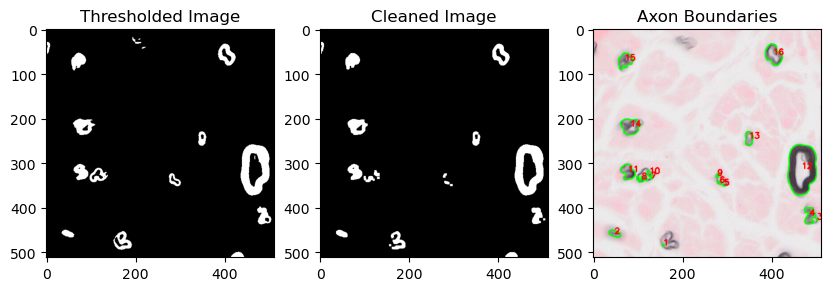

Processed systematic_patch_14.png - Axons detected: 23

Axon 1:
  Center = (306.00, 22.00)
  Outer Radius = 0.2985 µm
  Inner Radius = 0.2985 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (306.00, 22.00)
  Outer Radius = 1.0593 µm
  Inner Radius = 1.0593 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (306.00, 22.00)
  Outer Radius = 1.4900 µm
  Inner Radius = 1.4900 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (306.00, 22.00)
  Outer Radius = 2.8613 µm
  Inner Radius = 2.8613 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (306.00, 22.00)
  Outer Radius = 2.0618 µm
  Inner Radius = 2.0618 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (306.00, 22.00)
  Outer Radius = 0.8253 µm
  Inner Radius = 0.8253 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (306.00, 22.00)
  Outer Radius = 0.3241 µm
  Inner Radius = 0.3241 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (306.00, 22.00)
  Outer Radius = 1.7458 µm
  Inner Radius = 1.7458 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (306.00, 22.0

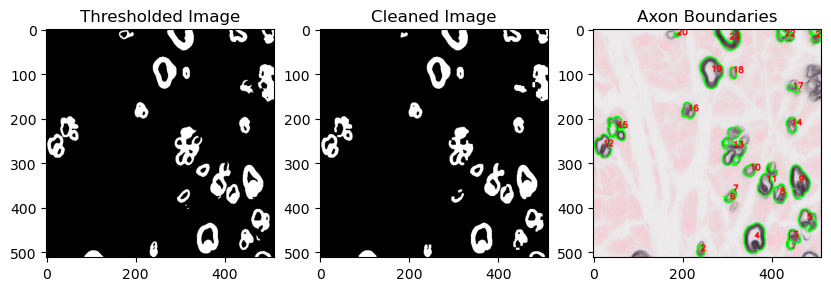

Processed systematic_patch_15.png - Axons detected: 17

Axon 1:
  Center = (25.00, 15.00)
  Outer Radius = 0.2985 µm
  Inner Radius = 0.2985 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (25.00, 15.00)
  Outer Radius = 2.3993 µm
  Inner Radius = 2.3993 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (25.00, 15.00)
  Outer Radius = 3.0685 µm
  Inner Radius = 3.0685 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (25.00, 15.00)
  Outer Radius = 3.1117 µm
  Inner Radius = 3.1117 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (25.00, 15.00)
  Outer Radius = 1.2716 µm
  Inner Radius = 1.2716 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (25.00, 15.00)
  Outer Radius = 0.9788 µm
  Inner Radius = 0.9788 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (25.00, 15.00)
  Outer Radius = 0.2148 µm
  Inner Radius = 0.2148 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (25.00, 15.00)
  Outer Radius = 1.8788 µm
  Inner Radius = 1.8788 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (25.00, 15.00)
  Oute

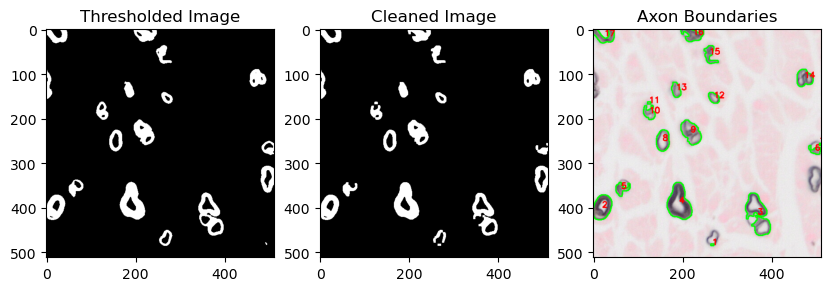

Processed systematic_patch_16.png - Axons detected: 16

Axon 1:
  Center = (67.00, 51.00)
  Outer Radius = 2.2844 µm
  Inner Radius = 2.2844 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (67.00, 51.00)
  Outer Radius = 1.2847 µm
  Inner Radius = 1.2847 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (67.00, 51.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (67.00, 51.00)
  Outer Radius = 1.2015 µm
  Inner Radius = 1.2015 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (67.00, 51.00)
  Outer Radius = 2.1369 µm
  Inner Radius = 2.1369 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (67.00, 51.00)
  Outer Radius = 1.2909 µm
  Inner Radius = 1.2909 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (67.00, 51.00)
  Outer Radius = 2.1357 µm
  Inner Radius = 2.1357 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (67.00, 51.00)
  Outer Radius = 2.8754 µm
  Inner Radius = 2.8754 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (67.00, 51.00)
  Oute

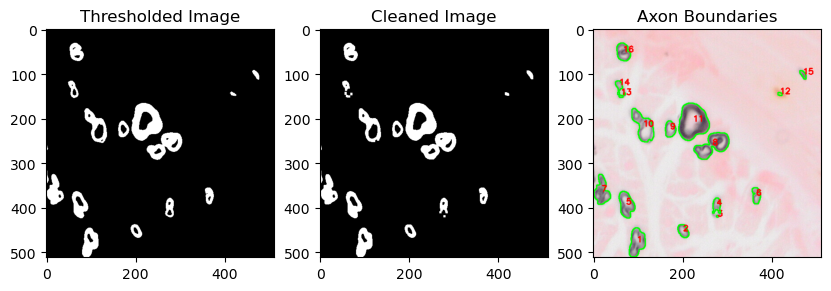

Processed systematic_patch_17.png - Axons detected: 14

Axon 1:
  Center = (502.00, 10.00)
  Outer Radius = 1.0874 µm
  Inner Radius = 1.0874 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (502.00, 10.00)
  Outer Radius = 0.6640 µm
  Inner Radius = 0.6640 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (502.00, 10.00)
  Outer Radius = 0.4442 µm
  Inner Radius = 0.4442 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (502.00, 10.00)
  Outer Radius = 0.4068 µm
  Inner Radius = 0.4068 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (502.00, 10.00)
  Outer Radius = 0.2985 µm
  Inner Radius = 0.2985 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (502.00, 10.00)
  Outer Radius = 1.6893 µm
  Inner Radius = 1.6893 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (502.00, 10.00)
  Outer Radius = 1.2463 µm
  Inner Radius = 1.2463 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (502.00, 10.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (502.00, 10.0

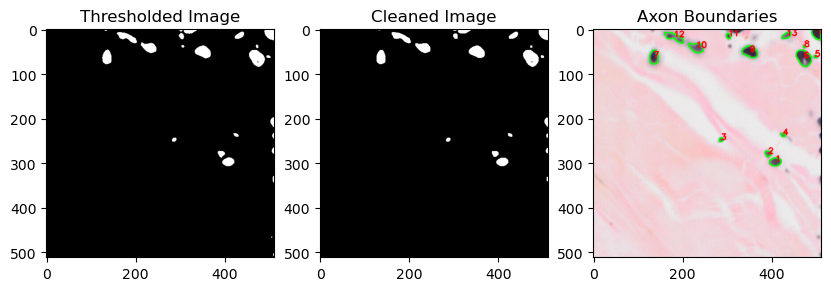

Processed systematic_patch_18.png - Axons detected: 43

Axon 1:
  Center = (17.00, 26.00)
  Outer Radius = 0.3290 µm
  Inner Radius = 0.3290 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (17.00, 26.00)
  Outer Radius = 0.8244 µm
  Inner Radius = 0.8244 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (17.00, 26.00)
  Outer Radius = 1.8567 µm
  Inner Radius = 1.8567 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (17.00, 26.00)
  Outer Radius = 1.2186 µm
  Inner Radius = 1.2186 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (17.00, 26.00)
  Outer Radius = 1.1403 µm
  Inner Radius = 1.1403 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (17.00, 26.00)
  Outer Radius = 1.8750 µm
  Inner Radius = 1.8750 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (17.00, 26.00)
  Outer Radius = 1.8138 µm
  Inner Radius = 1.8138 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (17.00, 26.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (17.00, 26.00)
  Oute

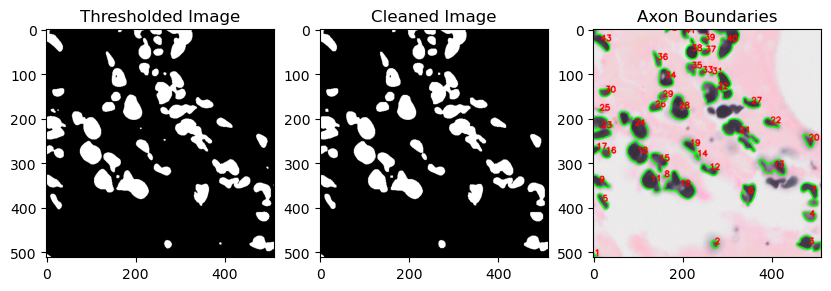

Processed systematic_patch_19.png - Axons detected: 12

Axon 1:
  Center = (426.00, 11.00)
  Outer Radius = 1.3007 µm
  Inner Radius = 1.3007 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (426.00, 11.00)
  Outer Radius = 1.1063 µm
  Inner Radius = 1.1063 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (426.00, 11.00)
  Outer Radius = 0.2821 µm
  Inner Radius = 0.2821 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (426.00, 11.00)
  Outer Radius = 1.2489 µm
  Inner Radius = 1.2489 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (426.00, 11.00)
  Outer Radius = 1.0786 µm
  Inner Radius = 1.0786 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (426.00, 11.00)
  Outer Radius = 0.6852 µm
  Inner Radius = 0.6852 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (426.00, 11.00)
  Outer Radius = 1.4122 µm
  Inner Radius = 1.4122 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (426.00, 11.00)
  Outer Radius = 0.4107 µm
  Inner Radius = 0.4107 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (426.00, 11.0

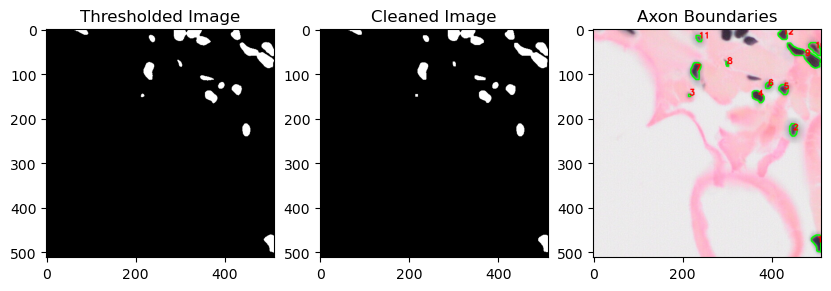

Processed systematic_patch_2.png - Axons detected: 4

Axon 1:
  Center = (54.00, 11.00)
  Outer Radius = 0.7389 µm
  Inner Radius = 0.7389 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (54.00, 11.00)
  Outer Radius = 2.1524 µm
  Inner Radius = 2.1524 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (54.00, 11.00)
  Outer Radius = 0.1954 µm
  Inner Radius = 0.1954 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (54.00, 11.00)
  Outer Radius = 0.6155 µm
  Inner Radius = 0.6155 µm
  Thickness = 0.0000 µm



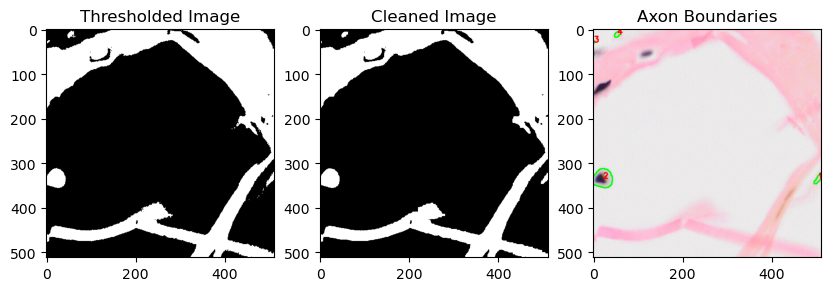

Processed systematic_patch_20.png - Axons detected: 4

Axon 1:
  Center = (51.00, 25.00)
  Outer Radius = 1.3086 µm
  Inner Radius = 1.3086 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (51.00, 25.00)
  Outer Radius = 2.1484 µm
  Inner Radius = 2.1484 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (51.00, 25.00)
  Outer Radius = 2.1357 µm
  Inner Radius = 2.1357 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (51.00, 25.00)
  Outer Radius = 0.5046 µm
  Inner Radius = 0.5046 µm
  Thickness = 0.0000 µm



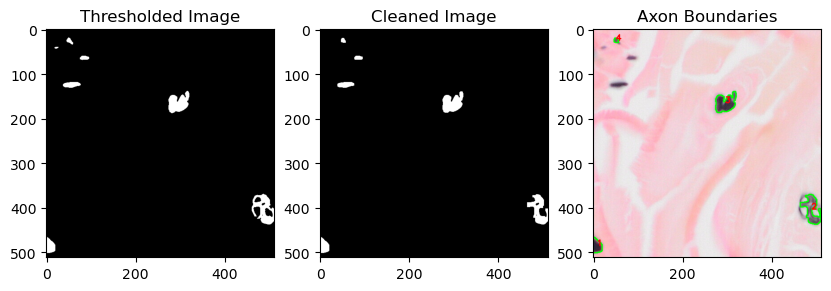

Processed systematic_patch_21.png - Axons detected: 14

Axon 1:
  Center = (246.00, 12.00)
  Outer Radius = 2.1646 µm
  Inner Radius = 2.1646 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (246.00, 12.00)
  Outer Radius = 0.7001 µm
  Inner Radius = 0.7001 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (246.00, 12.00)
  Outer Radius = 1.1528 µm
  Inner Radius = 1.1528 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (246.00, 12.00)
  Outer Radius = 0.4406 µm
  Inner Radius = 0.4406 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (246.00, 12.00)
  Outer Radius = 0.6270 µm
  Inner Radius = 0.6270 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (246.00, 12.00)
  Outer Radius = 1.6259 µm
  Inner Radius = 1.6259 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (246.00, 12.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (246.00, 12.00)
  Outer Radius = 1.0124 µm
  Inner Radius = 1.0124 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (246.00, 12.0

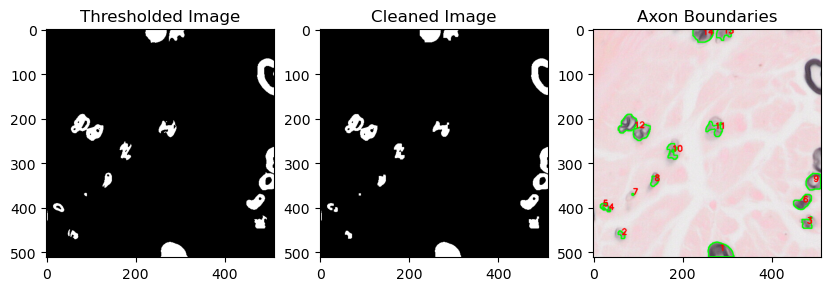

Processed systematic_patch_22.png - Axons detected: 19

Axon 1:
  Center = (427.00, 15.00)
  Outer Radius = 1.8014 µm
  Inner Radius = 1.8014 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (427.00, 15.00)
  Outer Radius = 0.7192 µm
  Inner Radius = 0.7192 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (427.00, 15.00)
  Outer Radius = 0.9715 µm
  Inner Radius = 0.9715 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (427.00, 15.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (427.00, 15.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (427.00, 15.00)
  Outer Radius = 2.1346 µm
  Inner Radius = 2.1346 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (427.00, 15.00)
  Outer Radius = 1.5625 µm
  Inner Radius = 1.5625 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (427.00, 15.00)
  Outer Radius = 3.9980 µm
  Inner Radius = 3.9980 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (427.00, 15.0

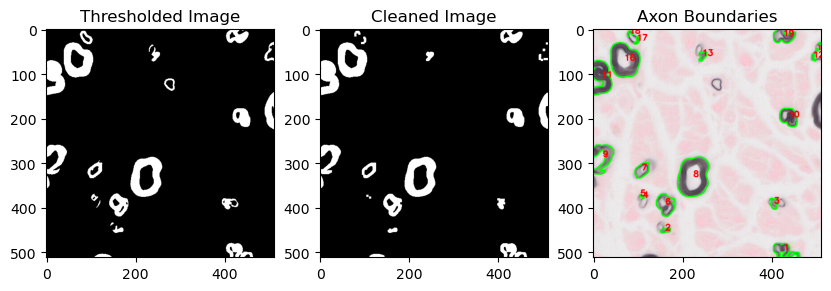

Processed systematic_patch_23.png - Axons detected: 12

Axon 1:
  Center = (99.00, 32.00)
  Outer Radius = 0.1913 µm
  Inner Radius = 0.1913 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (99.00, 32.00)
  Outer Radius = 0.6433 µm
  Inner Radius = 0.6433 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (99.00, 32.00)
  Outer Radius = 1.3669 µm
  Inner Radius = 1.3669 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (99.00, 32.00)
  Outer Radius = 1.3929 µm
  Inner Radius = 1.3929 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (99.00, 32.00)
  Outer Radius = 0.3969 µm
  Inner Radius = 0.3969 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (99.00, 32.00)
  Outer Radius = 3.5207 µm
  Inner Radius = 3.5207 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (99.00, 32.00)
  Outer Radius = 2.9441 µm
  Inner Radius = 2.9441 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (99.00, 32.00)
  Outer Radius = 0.1954 µm
  Inner Radius = 0.1954 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (99.00, 32.00)
  Oute

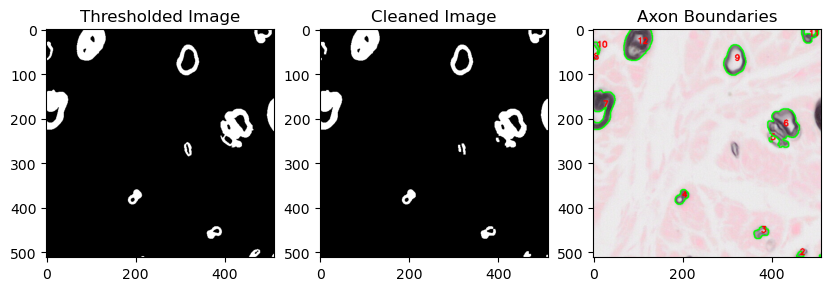

Processed systematic_patch_24.png - Axons detected: 19

Axon 1:
  Center = (478.00, 124.00)
  Outer Radius = 0.5628 µm
  Inner Radius = 0.5628 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (478.00, 124.00)
  Outer Radius = 1.0449 µm
  Inner Radius = 1.0449 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (478.00, 124.00)
  Outer Radius = 1.2386 µm
  Inner Radius = 1.2386 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (478.00, 124.00)
  Outer Radius = 2.2244 µm
  Inner Radius = 2.2244 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (478.00, 124.00)
  Outer Radius = 0.8930 µm
  Inner Radius = 0.8930 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (478.00, 124.00)
  Outer Radius = 2.1151 µm
  Inner Radius = 2.1151 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (478.00, 124.00)
  Outer Radius = 1.6097 µm
  Inner Radius = 1.6097 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (478.00, 124.00)
  Outer Radius = 3.4982 µm
  Inner Radius = 3.4982 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (478.

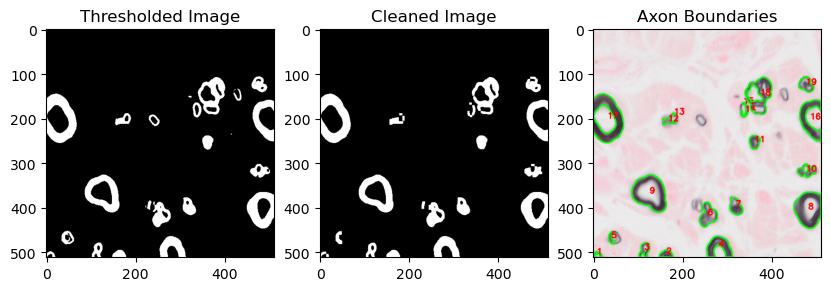

Processed systematic_patch_25.png - Axons detected: 13

Axon 1:
  Center = (430.00, 86.00)
  Outer Radius = 1.7348 µm
  Inner Radius = 1.7348 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (430.00, 86.00)
  Outer Radius = 2.0471 µm
  Inner Radius = 2.0471 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (430.00, 86.00)
  Outer Radius = 0.8147 µm
  Inner Radius = 0.8147 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (430.00, 86.00)
  Outer Radius = 1.9319 µm
  Inner Radius = 1.9319 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (430.00, 86.00)
  Outer Radius = 4.1419 µm
  Inner Radius = 4.1419 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (430.00, 86.00)
  Outer Radius = 2.1208 µm
  Inner Radius = 2.1208 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (430.00, 86.00)
  Outer Radius = 1.5691 µm
  Inner Radius = 1.5691 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (430.00, 86.00)
  Outer Radius = 2.7437 µm
  Inner Radius = 2.7437 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (430.00, 86.0

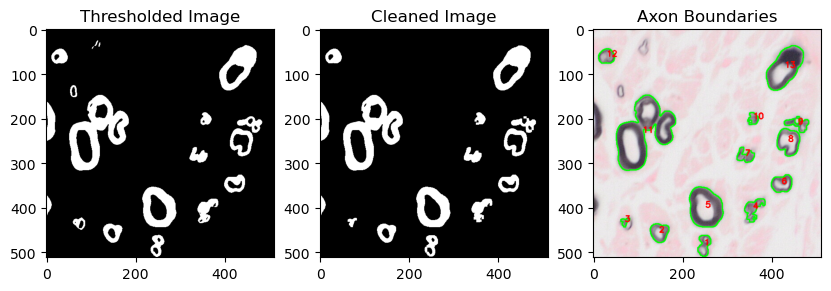

Processed systematic_patch_26.png - Axons detected: 8

Axon 1:
  Center = (222.00, 64.00)
  Outer Radius = 0.4951 µm
  Inner Radius = 0.4951 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (222.00, 64.00)
  Outer Radius = 1.9503 µm
  Inner Radius = 1.9503 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (222.00, 64.00)
  Outer Radius = 1.1624 µm
  Inner Radius = 1.1624 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (222.00, 64.00)
  Outer Radius = 2.8045 µm
  Inner Radius = 2.8045 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (222.00, 64.00)
  Outer Radius = 0.8019 µm
  Inner Radius = 0.8019 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (222.00, 64.00)
  Outer Radius = 0.9045 µm
  Inner Radius = 0.9045 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (222.00, 64.00)
  Outer Radius = 1.1248 µm
  Inner Radius = 1.1248 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (222.00, 64.00)
  Outer Radius = 1.0630 µm
  Inner Radius = 1.0630 µm
  Thickness = 0.0000 µm



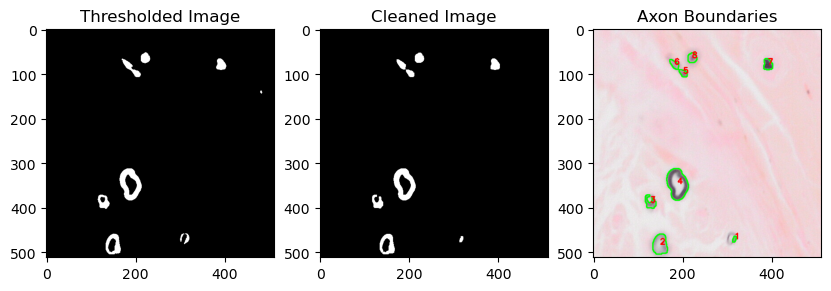

Processed systematic_patch_27.png - Axons detected: 9

Axon 1:
  Center = (9.00, 6.00)
  Outer Radius = 1.1149 µm
  Inner Radius = 1.1149 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (9.00, 6.00)
  Outer Radius = 0.7024 µm
  Inner Radius = 0.7024 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (9.00, 6.00)
  Outer Radius = 3.2223 µm
  Inner Radius = 3.2223 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (9.00, 6.00)
  Outer Radius = 0.3546 µm
  Inner Radius = 0.3546 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (9.00, 6.00)
  Outer Radius = 0.4771 µm
  Inner Radius = 0.4771 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (9.00, 6.00)
  Outer Radius = 1.4691 µm
  Inner Radius = 1.4691 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (9.00, 6.00)
  Outer Radius = 1.3546 µm
  Inner Radius = 1.3546 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (9.00, 6.00)
  Outer Radius = 0.9398 µm
  Inner Radius = 0.9398 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (9.00, 6.00)
  Outer Radius = 0.6794 µ

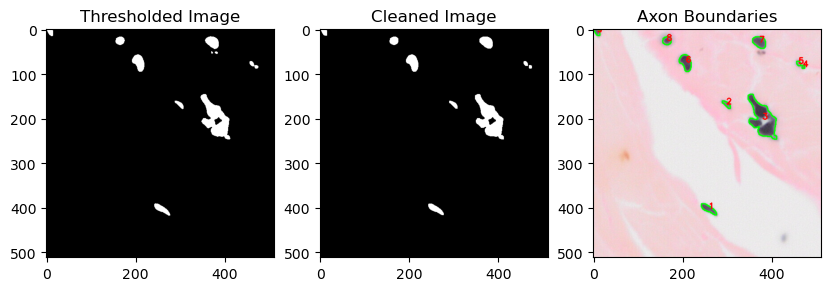

Processed systematic_patch_28.png - Axons detected: 3

Axon 1:
  Center = (276.00, 30.00)
  Outer Radius = 1.1841 µm
  Inner Radius = 1.1841 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (276.00, 30.00)
  Outer Radius = 2.2291 µm
  Inner Radius = 2.2291 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (276.00, 30.00)
  Outer Radius = 2.7952 µm
  Inner Radius = 2.7952 µm
  Thickness = 0.0000 µm



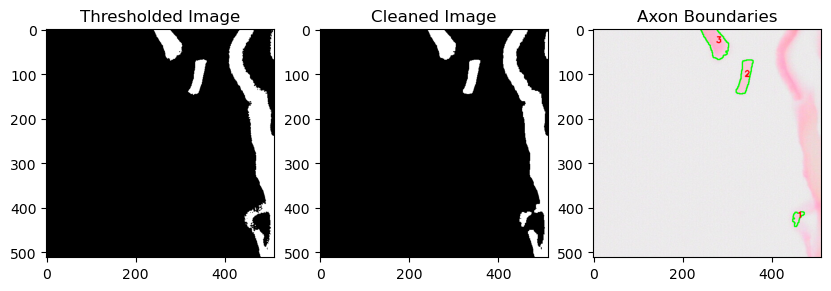

Processed systematic_patch_29.png - Axons detected: 5

Axon 1:
  Center = (484.00, 87.00)
  Outer Radius = 1.4212 µm
  Inner Radius = 1.4212 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (484.00, 87.00)
  Outer Radius = 0.7527 µm
  Inner Radius = 0.7527 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (484.00, 87.00)
  Outer Radius = 1.5002 µm
  Inner Radius = 1.5002 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (484.00, 87.00)
  Outer Radius = 0.4241 µm
  Inner Radius = 0.4241 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (484.00, 87.00)
  Outer Radius = 1.4615 µm
  Inner Radius = 1.4615 µm
  Thickness = 0.0000 µm



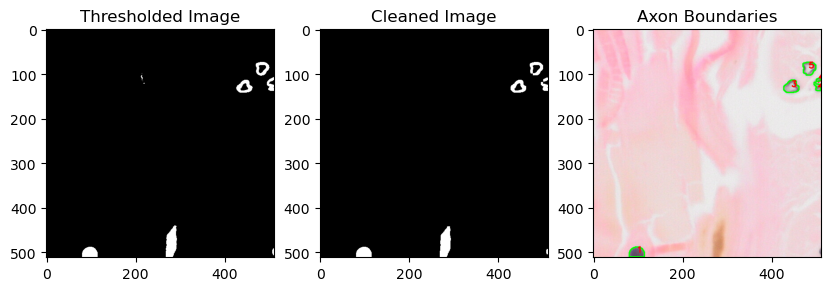

Processed systematic_patch_3.png - Axons detected: 7

Axon 1:
  Center = (272.00, 68.00)
  Outer Radius = 0.7148 µm
  Inner Radius = 0.7148 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (272.00, 68.00)
  Outer Radius = 4.5852 µm
  Inner Radius = 4.5852 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (272.00, 68.00)
  Outer Radius = 1.7029 µm
  Inner Radius = 1.7029 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (272.00, 68.00)
  Outer Radius = 0.6759 µm
  Inner Radius = 0.6759 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (272.00, 68.00)
  Outer Radius = 2.0062 µm
  Inner Radius = 2.0062 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (272.00, 68.00)
  Outer Radius = 3.4533 µm
  Inner Radius = 3.4533 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (272.00, 68.00)
  Outer Radius = 0.5877 µm
  Inner Radius = 0.5877 µm
  Thickness = 0.0000 µm



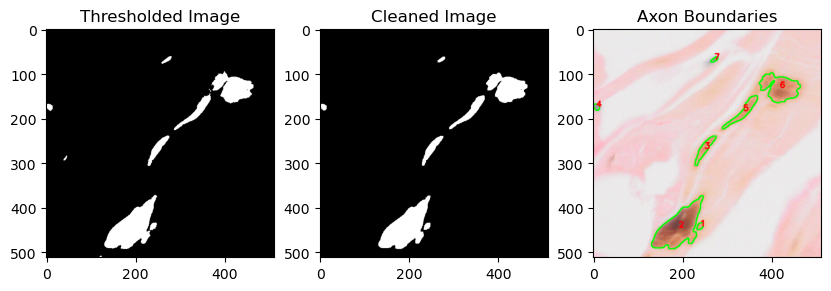

Processed systematic_patch_30.png - Axons detected: 15

Axon 1:
  Center = (289.00, 22.00)
  Outer Radius = 0.3700 µm
  Inner Radius = 0.3700 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (289.00, 22.00)
  Outer Radius = 1.2348 µm
  Inner Radius = 1.2348 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (289.00, 22.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (289.00, 22.00)
  Outer Radius = 2.8599 µm
  Inner Radius = 2.8599 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (289.00, 22.00)
  Outer Radius = 1.1248 µm
  Inner Radius = 1.1248 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (289.00, 22.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (289.00, 22.00)
  Outer Radius = 1.7970 µm
  Inner Radius = 1.7970 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (289.00, 22.00)
  Outer Radius = 1.0712 µm
  Inner Radius = 1.0712 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (289.00, 22.0

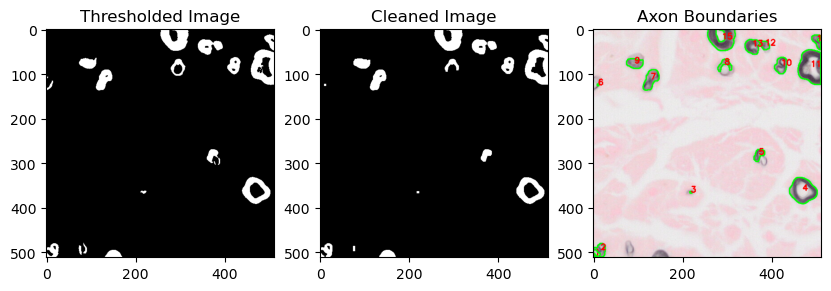

Processed systematic_patch_31.png - Axons detected: 15

Axon 1:
  Center = (127.00, 33.00)
  Outer Radius = 0.4754 µm
  Inner Radius = 0.4754 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (127.00, 33.00)
  Outer Radius = 1.3611 µm
  Inner Radius = 1.3611 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (127.00, 33.00)
  Outer Radius = 0.6770 µm
  Inner Radius = 0.6770 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (127.00, 33.00)
  Outer Radius = 1.4653 µm
  Inner Radius = 1.4653 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (127.00, 33.00)
  Outer Radius = 1.4620 µm
  Inner Radius = 1.4620 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (127.00, 33.00)
  Outer Radius = 0.3523 µm
  Inner Radius = 0.3523 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (127.00, 33.00)
  Outer Radius = 1.0808 µm
  Inner Radius = 1.0808 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (127.00, 33.00)
  Outer Radius = 2.3970 µm
  Inner Radius = 2.3970 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (127.00, 33.0

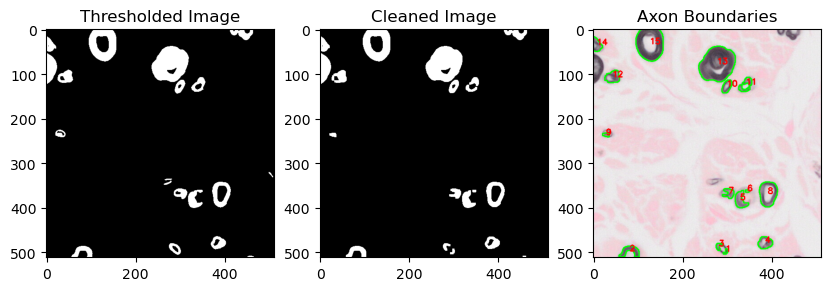

Processed systematic_patch_32.png - Axons detected: 19

Axon 1:
  Center = (230.00, 18.00)
  Outer Radius = 2.0947 µm
  Inner Radius = 2.0947 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (230.00, 18.00)
  Outer Radius = 0.7421 µm
  Inner Radius = 0.7421 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (230.00, 18.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (230.00, 18.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (230.00, 18.00)
  Outer Radius = 1.4906 µm
  Inner Radius = 1.4906 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (230.00, 18.00)
  Outer Radius = 2.4109 µm
  Inner Radius = 2.4109 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (230.00, 18.00)
  Outer Radius = 0.2764 µm
  Inner Radius = 0.2764 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (230.00, 18.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (230.00, 18.0

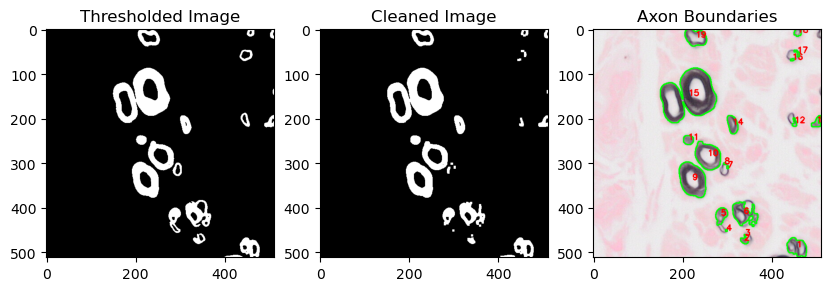

Processed systematic_patch_33.png - Axons detected: 19

Axon 1:
  Center = (12.00, 10.00)
  Outer Radius = 1.8502 µm
  Inner Radius = 1.8502 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (12.00, 10.00)
  Outer Radius = 1.4505 µm
  Inner Radius = 1.4505 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (12.00, 10.00)
  Outer Radius = 1.6205 µm
  Inner Radius = 1.6205 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (12.00, 10.00)
  Outer Radius = 1.9670 µm
  Inner Radius = 1.9670 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (12.00, 10.00)
  Outer Radius = 1.5270 µm
  Inner Radius = 1.5270 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (12.00, 10.00)
  Outer Radius = 1.9265 µm
  Inner Radius = 1.9265 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (12.00, 10.00)
  Outer Radius = 1.5543 µm
  Inner Radius = 1.5543 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (12.00, 10.00)
  Outer Radius = 1.9356 µm
  Inner Radius = 1.9356 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (12.00, 10.00)
  Oute

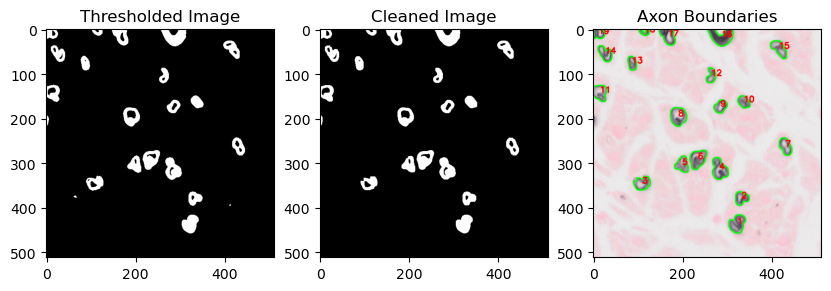

Processed systematic_patch_34.png - Axons detected: 8

Axon 1:
  Center = (476.00, 193.00)
  Outer Radius = 0.7653 µm
  Inner Radius = 0.7653 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (476.00, 193.00)
  Outer Radius = 2.3446 µm
  Inner Radius = 2.3446 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (476.00, 193.00)
  Outer Radius = 1.5207 µm
  Inner Radius = 1.5207 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (476.00, 193.00)
  Outer Radius = 1.4653 µm
  Inner Radius = 1.4653 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (476.00, 193.00)
  Outer Radius = 1.2231 µm
  Inner Radius = 1.2231 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (476.00, 193.00)
  Outer Radius = 1.5254 µm
  Inner Radius = 1.5254 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (476.00, 193.00)
  Outer Radius = 1.6869 µm
  Inner Radius = 1.6869 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (476.00, 193.00)
  Outer Radius = 3.2359 µm
  Inner Radius = 3.2359 µm
  Thickness = 0.0000 µm



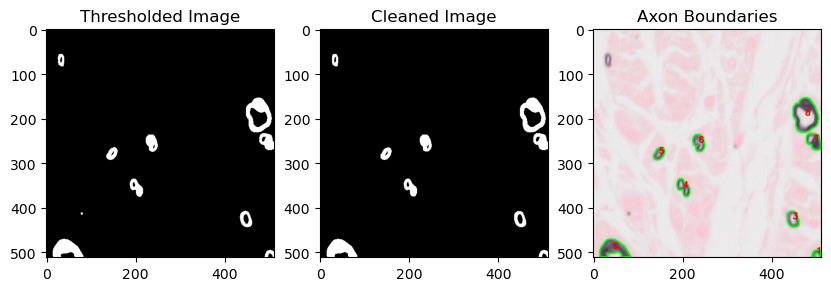

Processed systematic_patch_35.png - Axons detected: 26

Axon 1:
  Center = (337.00, 31.00)
  Outer Radius = 0.3409 µm
  Inner Radius = 0.3409 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (337.00, 31.00)
  Outer Radius = 0.4951 µm
  Inner Radius = 0.4951 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (337.00, 31.00)
  Outer Radius = 0.3432 µm
  Inner Radius = 0.3432 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (337.00, 31.00)
  Outer Radius = 0.6358 µm
  Inner Radius = 0.6358 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (337.00, 31.00)
  Outer Radius = 0.3827 µm
  Inner Radius = 0.3827 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (337.00, 31.00)
  Outer Radius = 1.2747 µm
  Inner Radius = 1.2747 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (337.00, 31.00)
  Outer Radius = 0.5202 µm
  Inner Radius = 0.5202 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (337.00, 31.00)
  Outer Radius = 1.6991 µm
  Inner Radius = 1.6991 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (337.00, 31.0

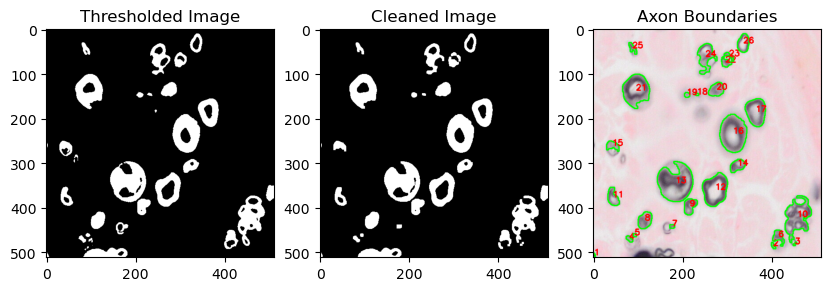

Processed systematic_patch_36.png - Axons detected: 1

Axon 1:
  Center = (418.00, 326.00)
  Outer Radius = 0.5125 µm
  Inner Radius = 0.5125 µm
  Thickness = 0.0000 µm



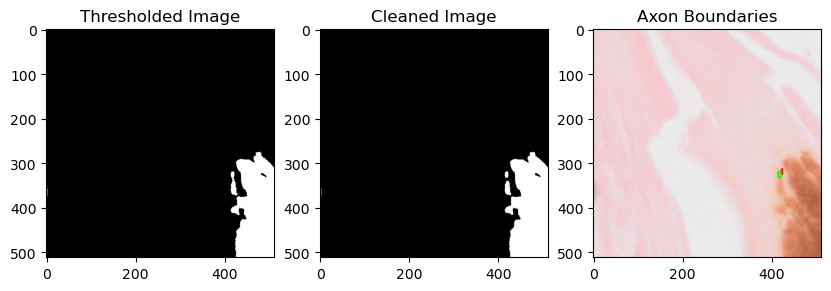

Processed systematic_patch_37.png - Axons detected: 1

Axon 1:
  Center = (507.00, 411.00)
  Outer Radius = 0.4635 µm
  Inner Radius = 0.4635 µm
  Thickness = 0.0000 µm



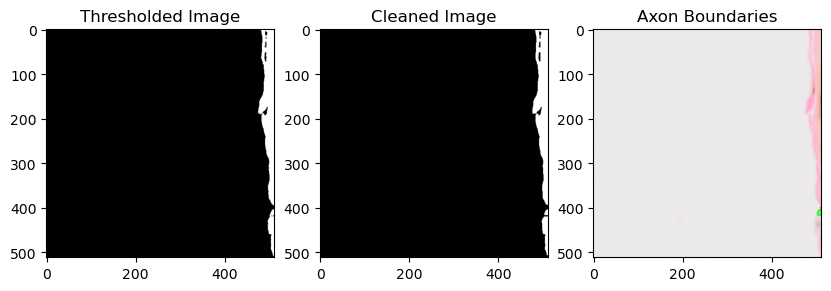

Processed systematic_patch_38.png - Axons detected: 9

Axon 1:
  Center = (97.00, 7.00)
  Outer Radius = 1.2087 µm
  Inner Radius = 1.2087 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (97.00, 7.00)
  Outer Radius = 2.0323 µm
  Inner Radius = 2.0323 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (97.00, 7.00)
  Outer Radius = 3.1451 µm
  Inner Radius = 3.1451 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (97.00, 7.00)
  Outer Radius = 0.9202 µm
  Inner Radius = 0.9202 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (97.00, 7.00)
  Outer Radius = 1.7716 µm
  Inner Radius = 1.7716 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (97.00, 7.00)
  Outer Radius = 1.6022 µm
  Inner Radius = 1.6022 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (97.00, 7.00)
  Outer Radius = 0.3969 µm
  Inner Radius = 0.3969 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (97.00, 7.00)
  Outer Radius = 0.5917 µm
  Inner Radius = 0.5917 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (97.00, 7.00)
  Outer Radius =

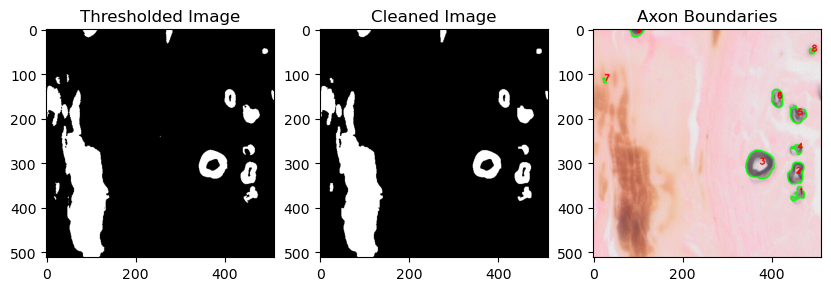

Processed systematic_patch_39.png - Axons detected: 19

Axon 1:
  Center = (125.00, 37.00)
  Outer Radius = 0.6457 µm
  Inner Radius = 0.6457 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (125.00, 37.00)
  Outer Radius = 2.2408 µm
  Inner Radius = 2.2408 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (125.00, 37.00)
  Outer Radius = 2.2886 µm
  Inner Radius = 2.2886 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (125.00, 37.00)
  Outer Radius = 3.0422 µm
  Inner Radius = 3.0422 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (125.00, 37.00)
  Outer Radius = 1.4549 µm
  Inner Radius = 1.4549 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (125.00, 37.00)
  Outer Radius = 2.3463 µm
  Inner Radius = 2.3463 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (125.00, 37.00)
  Outer Radius = 3.5100 µm
  Inner Radius = 3.5100 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (125.00, 37.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (125.00, 37.0

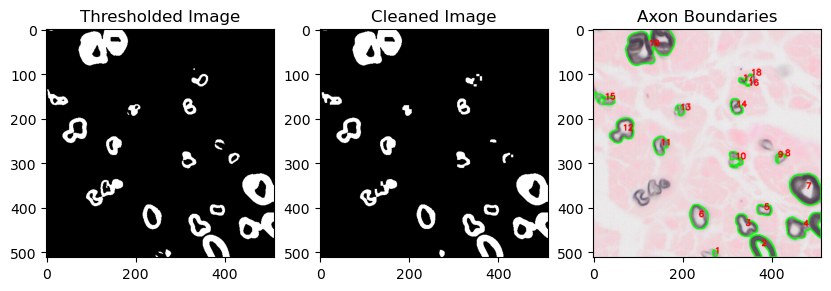

Processed systematic_patch_4.png - Axons detected: 8

Axon 1:
  Center = (443.00, 193.00)
  Outer Radius = 0.9330 µm
  Inner Radius = 0.9330 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (443.00, 193.00)
  Outer Radius = 1.1354 µm
  Inner Radius = 1.1354 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (443.00, 193.00)
  Outer Radius = 1.4467 µm
  Inner Radius = 1.4467 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (443.00, 193.00)
  Outer Radius = 1.6864 µm
  Inner Radius = 1.6864 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (443.00, 193.00)
  Outer Radius = 2.4089 µm
  Inner Radius = 2.4089 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (443.00, 193.00)
  Outer Radius = 1.3333 µm
  Inner Radius = 1.3333 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (443.00, 193.00)
  Outer Radius = 2.7166 µm
  Inner Radius = 2.7166 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (443.00, 193.00)
  Outer Radius = 1.5081 µm
  Inner Radius = 1.5081 µm
  Thickness = 0.0000 µm



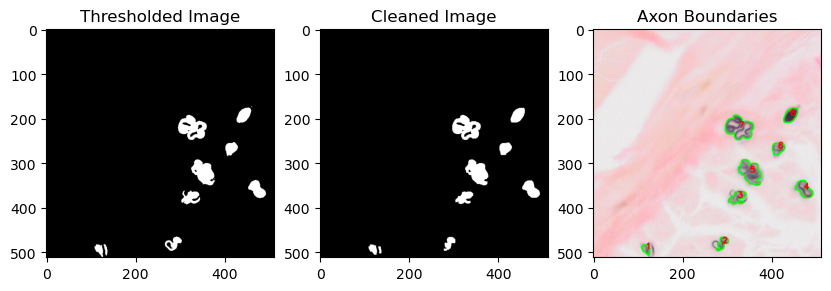

Processed systematic_patch_40.png - Axons detected: 18

Axon 1:
  Center = (80.00, 19.00)
  Outer Radius = 2.2394 µm
  Inner Radius = 2.2394 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (80.00, 19.00)
  Outer Radius = 1.7886 µm
  Inner Radius = 1.7886 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (80.00, 19.00)
  Outer Radius = 0.4737 µm
  Inner Radius = 0.4737 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (80.00, 19.00)
  Outer Radius = 2.9254 µm
  Inner Radius = 2.9254 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (80.00, 19.00)
  Outer Radius = 1.9650 µm
  Inner Radius = 1.9650 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (80.00, 19.00)
  Outer Radius = 1.6434 µm
  Inner Radius = 1.6434 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (80.00, 19.00)
  Outer Radius = 2.1690 µm
  Inner Radius = 2.1690 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (80.00, 19.00)
  Outer Radius = 0.6592 µm
  Inner Radius = 0.6592 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (80.00, 19.00)
  Oute

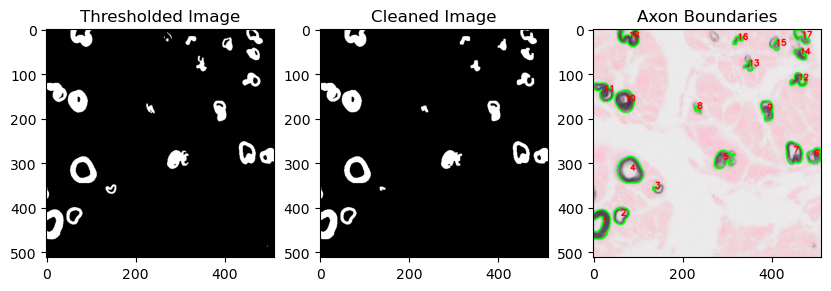

Processed systematic_patch_41.png - Axons detected: 14

Axon 1:
  Center = (421.00, 42.00)
  Outer Radius = 3.5209 µm
  Inner Radius = 3.5209 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (421.00, 42.00)
  Outer Radius = 2.1602 µm
  Inner Radius = 2.1602 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (421.00, 42.00)
  Outer Radius = 2.3887 µm
  Inner Radius = 2.3887 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (421.00, 42.00)
  Outer Radius = 2.6224 µm
  Inner Radius = 2.6224 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (421.00, 42.00)
  Outer Radius = 1.8028 µm
  Inner Radius = 1.8028 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (421.00, 42.00)
  Outer Radius = 0.4687 µm
  Inner Radius = 0.4687 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (421.00, 42.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (421.00, 42.00)
  Outer Radius = 0.7684 µm
  Inner Radius = 0.7684 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (421.00, 42.0

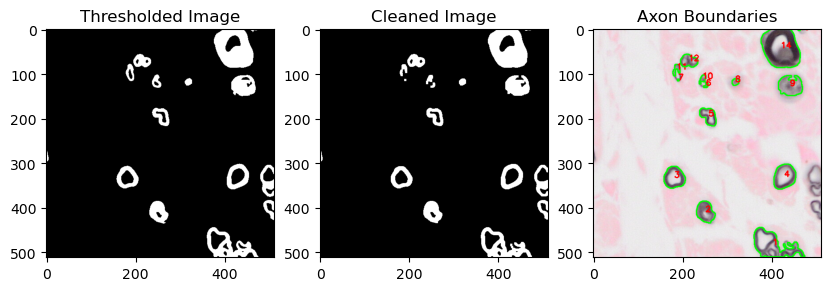

Processed systematic_patch_42.png - Axons detected: 17

Axon 1:
  Center = (39.00, 67.00)
  Outer Radius = 0.3192 µm
  Inner Radius = 0.3192 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (39.00, 67.00)
  Outer Radius = 1.1156 µm
  Inner Radius = 1.1156 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (39.00, 67.00)
  Outer Radius = 1.3249 µm
  Inner Radius = 1.3249 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (39.00, 67.00)
  Outer Radius = 2.9117 µm
  Inner Radius = 2.9117 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (39.00, 67.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (39.00, 67.00)
  Outer Radius = 1.2270 µm
  Inner Radius = 1.2270 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (39.00, 67.00)
  Outer Radius = 4.9469 µm
  Inner Radius = 4.9469 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (39.00, 67.00)
  Outer Radius = 2.1620 µm
  Inner Radius = 2.1620 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (39.00, 67.00)
  Oute

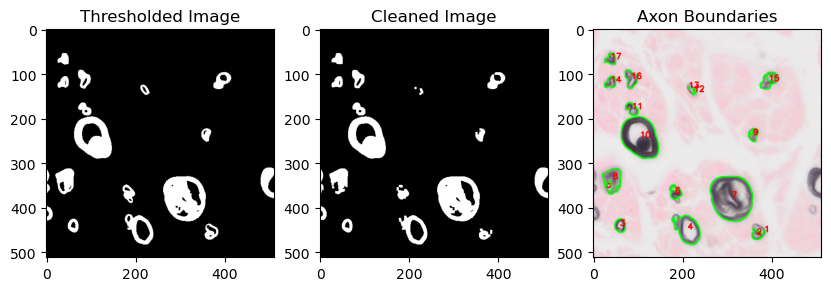

Processed systematic_patch_43.png - Axons detected: 13

Axon 1:
  Center = (55.00, 19.00)
  Outer Radius = 0.1954 µm
  Inner Radius = 0.1954 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (55.00, 19.00)
  Outer Radius = 3.0951 µm
  Inner Radius = 3.0951 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (55.00, 19.00)
  Outer Radius = 1.8308 µm
  Inner Radius = 1.8308 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (55.00, 19.00)
  Outer Radius = 3.5656 µm
  Inner Radius = 3.5656 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (55.00, 19.00)
  Outer Radius = 0.5125 µm
  Inner Radius = 0.5125 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (55.00, 19.00)
  Outer Radius = 1.1312 µm
  Inner Radius = 1.1312 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (55.00, 19.00)
  Outer Radius = 0.6735 µm
  Inner Radius = 0.6735 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (55.00, 19.00)
  Outer Radius = 1.7494 µm
  Inner Radius = 1.7494 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (55.00, 19.00)
  Oute

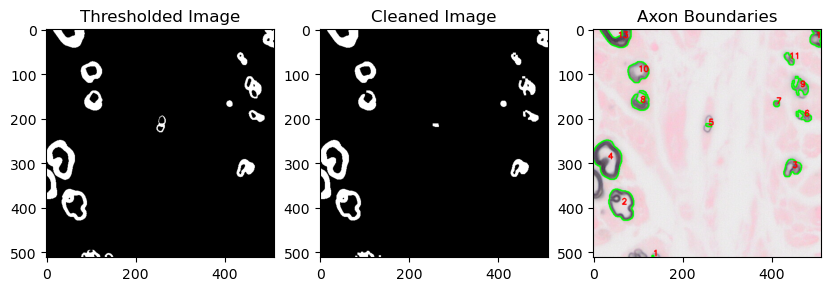

Processed systematic_patch_44.png - Axons detected: 20

Axon 1:
  Center = (88.00, 27.00)
  Outer Radius = 0.6232 µm
  Inner Radius = 0.6232 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (88.00, 27.00)
  Outer Radius = 0.7909 µm
  Inner Radius = 0.7909 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (88.00, 27.00)
  Outer Radius = 0.4424 µm
  Inner Radius = 0.4424 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (88.00, 27.00)
  Outer Radius = 3.4669 µm
  Inner Radius = 3.4669 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (88.00, 27.00)
  Outer Radius = 1.1767 µm
  Inner Radius = 1.1767 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (88.00, 27.00)
  Outer Radius = 4.7033 µm
  Inner Radius = 4.7033 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (88.00, 27.00)
  Outer Radius = 1.6579 µm
  Inner Radius = 1.6579 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (88.00, 27.00)
  Outer Radius = 1.1875 µm
  Inner Radius = 1.1875 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (88.00, 27.00)
  Oute

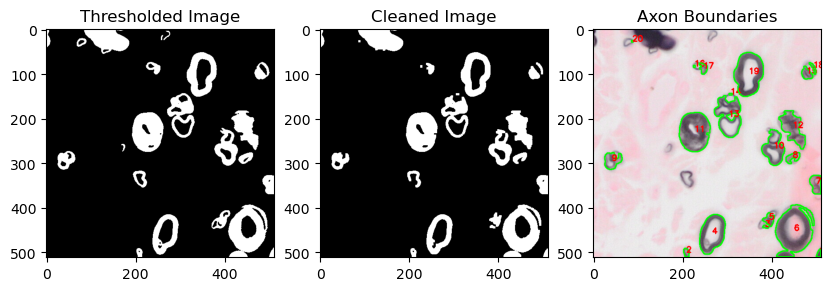

Processed systematic_patch_45.png - Axons detected: 3

Axon 1:
  Center = (476.00, 48.00)
  Outer Radius = 1.8399 µm
  Inner Radius = 1.8399 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (476.00, 48.00)
  Outer Radius = 1.5176 µm
  Inner Radius = 1.5176 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (476.00, 48.00)
  Outer Radius = 4.8117 µm
  Inner Radius = 4.8117 µm
  Thickness = 0.0000 µm



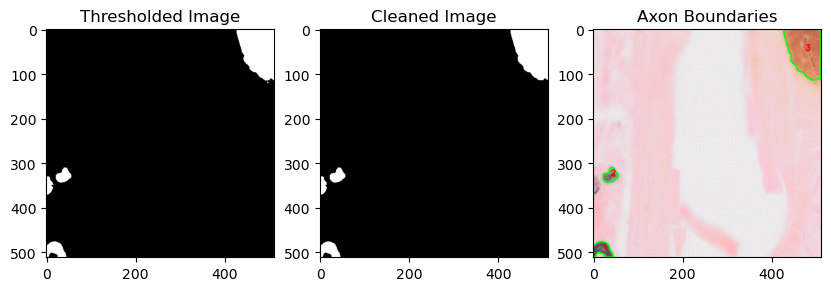

Processed systematic_patch_46.png - Axons detected: 470

Axon 1:
  Center = (298.00, 1.00)
  Outer Radius = 0.1954 µm
  Inner Radius = 0.1954 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (298.00, 1.00)
  Outer Radius = 0.2427 µm
  Inner Radius = 0.2427 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (298.00, 1.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (298.00, 1.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (298.00, 1.00)
  Outer Radius = 0.2585 µm
  Inner Radius = 0.2585 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (298.00, 1.00)
  Outer Radius = 0.2959 µm
  Inner Radius = 0.2959 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (298.00, 1.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (298.00, 1.00)
  Outer Radius = 0.4618 µm
  Inner Radius = 0.4618 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (298.00, 1.00)
  Out

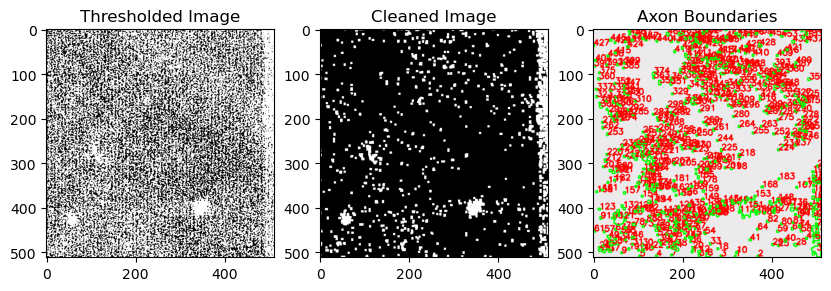

Processed systematic_patch_47.png - Axons detected: 7

Axon 1:
  Center = (100.00, 13.00)
  Outer Radius = 0.5513 µm
  Inner Radius = 0.5513 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (100.00, 13.00)
  Outer Radius = 3.6674 µm
  Inner Radius = 3.6674 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (100.00, 13.00)
  Outer Radius = 0.6805 µm
  Inner Radius = 0.6805 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (100.00, 13.00)
  Outer Radius = 1.3640 µm
  Inner Radius = 1.3640 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (100.00, 13.00)
  Outer Radius = 0.3038 µm
  Inner Radius = 0.3038 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (100.00, 13.00)
  Outer Radius = 2.3679 µm
  Inner Radius = 2.3679 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (100.00, 13.00)
  Outer Radius = 1.9273 µm
  Inner Radius = 1.9273 µm
  Thickness = 0.0000 µm



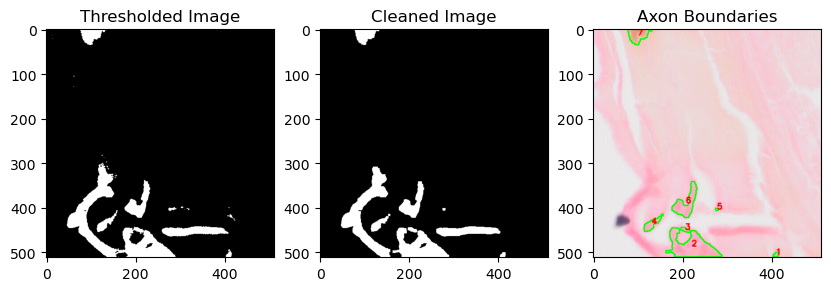

Processed systematic_patch_48.png - Axons detected: 12

Axon 1:
  Center = (389.00, 12.00)
  Outer Radius = 2.7573 µm
  Inner Radius = 2.7573 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (389.00, 12.00)
  Outer Radius = 1.3303 µm
  Inner Radius = 1.3303 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (389.00, 12.00)
  Outer Radius = 0.3827 µm
  Inner Radius = 0.3827 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (389.00, 12.00)
  Outer Radius = 1.5615 µm
  Inner Radius = 1.5615 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (389.00, 12.00)
  Outer Radius = 1.3303 µm
  Inner Radius = 1.3303 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (389.00, 12.00)
  Outer Radius = 1.2772 µm
  Inner Radius = 1.2772 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (389.00, 12.00)
  Outer Radius = 1.4544 µm
  Inner Radius = 1.4544 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (389.00, 12.00)
  Outer Radius = 1.5589 µm
  Inner Radius = 1.5589 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (389.00, 12.0

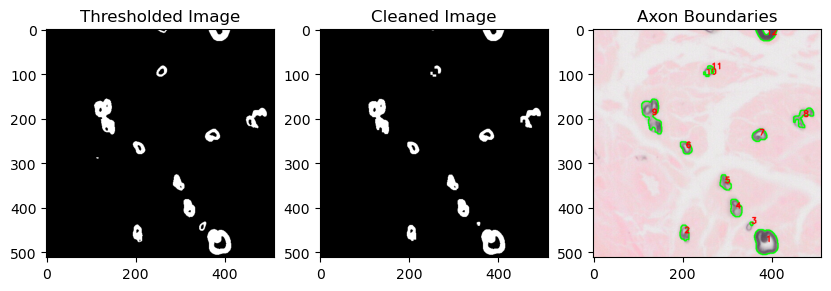

Processed systematic_patch_49.png - Axons detected: 17

Axon 1:
  Center = (484.00, 59.00)
  Outer Radius = 0.5740 µm
  Inner Radius = 0.5740 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (484.00, 59.00)
  Outer Radius = 0.5308 µm
  Inner Radius = 0.5308 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (484.00, 59.00)
  Outer Radius = 1.9714 µm
  Inner Radius = 1.9714 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (484.00, 59.00)
  Outer Radius = 0.3192 µm
  Inner Radius = 0.3192 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (484.00, 59.00)
  Outer Radius = 1.5630 µm
  Inner Radius = 1.5630 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (484.00, 59.00)
  Outer Radius = 1.7553 µm
  Inner Radius = 1.7553 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (484.00, 59.00)
  Outer Radius = 1.8028 µm
  Inner Radius = 1.8028 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (484.00, 59.00)
  Outer Radius = 0.6531 µm
  Inner Radius = 0.6531 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (484.00, 59.0

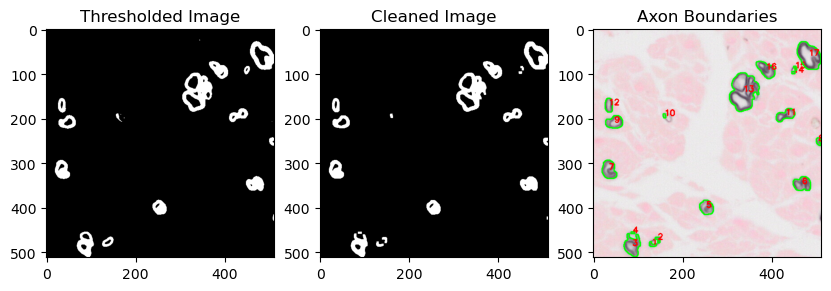

Processed systematic_patch_5.png - Axons detected: 15

Axon 1:
  Center = (228.00, 28.00)
  Outer Radius = 1.9670 µm
  Inner Radius = 1.9670 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (228.00, 28.00)
  Outer Radius = 0.6283 µm
  Inner Radius = 0.6283 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (228.00, 28.00)
  Outer Radius = 1.8256 µm
  Inner Radius = 1.8256 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (228.00, 28.00)
  Outer Radius = 4.4094 µm
  Inner Radius = 4.4094 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (228.00, 28.00)
  Outer Radius = 1.1747 µm
  Inner Radius = 1.1747 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (228.00, 28.00)
  Outer Radius = 1.4031 µm
  Inner Radius = 1.4031 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (228.00, 28.00)
  Outer Radius = 1.9158 µm
  Inner Radius = 1.9158 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (228.00, 28.00)
  Outer Radius = 1.1340 µm
  Inner Radius = 1.1340 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (228.00, 28.00

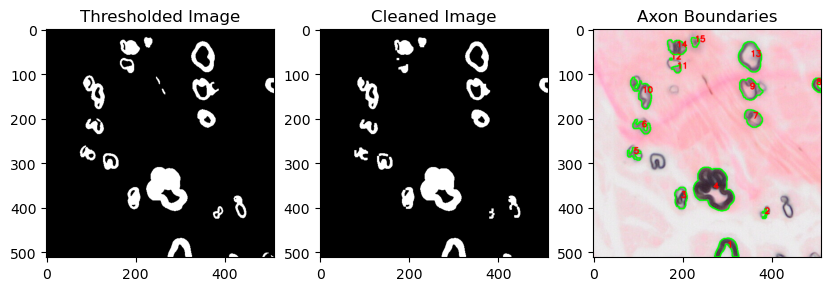

Processed systematic_patch_50.png - Axons detected: 18

Axon 1:
  Center = (454.00, 20.00)
  Outer Radius = 0.6628 µm
  Inner Radius = 0.6628 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (454.00, 20.00)
  Outer Radius = 1.1995 µm
  Inner Radius = 1.1995 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (454.00, 20.00)
  Outer Radius = 0.4088 µm
  Inner Radius = 0.4088 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (454.00, 20.00)
  Outer Radius = 1.2964 µm
  Inner Radius = 1.2964 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (454.00, 20.00)
  Outer Radius = 1.5722 µm
  Inner Radius = 1.5722 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (454.00, 20.00)
  Outer Radius = 0.4406 µm
  Inner Radius = 0.4406 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (454.00, 20.00)
  Outer Radius = 0.6887 µm
  Inner Radius = 0.6887 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (454.00, 20.00)
  Outer Radius = 0.8078 µm
  Inner Radius = 0.8078 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (454.00, 20.0

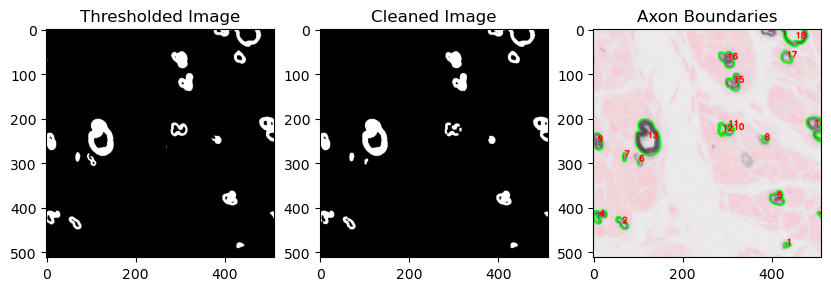

Processed systematic_patch_51.png - Axons detected: 7

Axon 1:
  Center = (66.00, 49.00)
  Outer Radius = 0.7559 µm
  Inner Radius = 0.7559 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (66.00, 49.00)
  Outer Radius = 2.6327 µm
  Inner Radius = 2.6327 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (66.00, 49.00)
  Outer Radius = 0.8406 µm
  Inner Radius = 0.8406 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (66.00, 49.00)
  Outer Radius = 1.5686 µm
  Inner Radius = 1.5686 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (66.00, 49.00)
  Outer Radius = 1.0653 µm
  Inner Radius = 1.0653 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (66.00, 49.00)
  Outer Radius = 3.2633 µm
  Inner Radius = 3.2633 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (66.00, 49.00)
  Outer Radius = 3.5949 µm
  Inner Radius = 3.5949 µm
  Thickness = 0.0000 µm



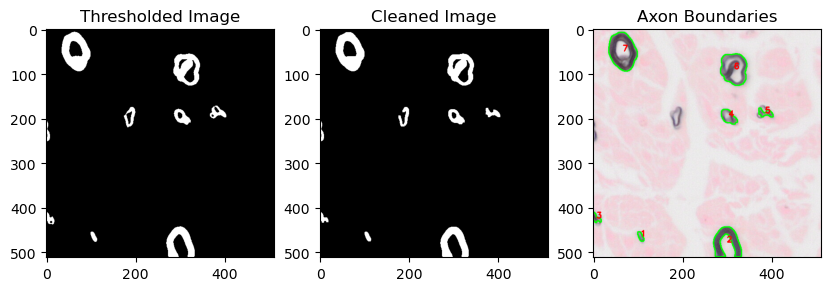

Processed systematic_patch_52.png - Axons detected: 8

Axon 1:
  Center = (104.00, 14.00)
  Outer Radius = 1.3820 µm
  Inner Radius = 1.3820 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (104.00, 14.00)
  Outer Radius = 1.4571 µm
  Inner Radius = 1.4571 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (104.00, 14.00)
  Outer Radius = 1.3623 µm
  Inner Radius = 1.3623 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (104.00, 14.00)
  Outer Radius = 1.1720 µm
  Inner Radius = 1.1720 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (104.00, 14.00)
  Outer Radius = 2.5209 µm
  Inner Radius = 2.5209 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (104.00, 14.00)
  Outer Radius = 1.7603 µm
  Inner Radius = 1.7603 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (104.00, 14.00)
  Outer Radius = 0.8234 µm
  Inner Radius = 0.8234 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (104.00, 14.00)
  Outer Radius = 1.8277 µm
  Inner Radius = 1.8277 µm
  Thickness = 0.0000 µm



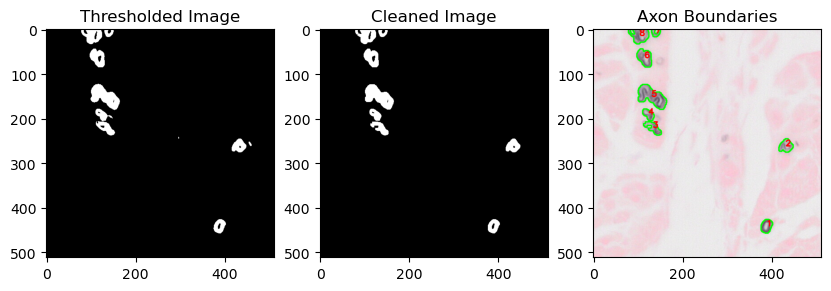

Processed systematic_patch_53.png - Axons detected: 22

Axon 1:
  Center = (211.00, 8.00)
  Outer Radius = 1.6545 µm
  Inner Radius = 1.6545 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (211.00, 8.00)
  Outer Radius = 3.4469 µm
  Inner Radius = 3.4469 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (211.00, 8.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (211.00, 8.00)
  Outer Radius = 0.2764 µm
  Inner Radius = 0.2764 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (211.00, 8.00)
  Outer Radius = 0.6283 µm
  Inner Radius = 0.6283 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (211.00, 8.00)
  Outer Radius = 1.7581 µm
  Inner Radius = 1.7581 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (211.00, 8.00)
  Outer Radius = 0.8713 µm
  Inner Radius = 0.8713 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (211.00, 8.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (211.00, 8.00)
  Oute

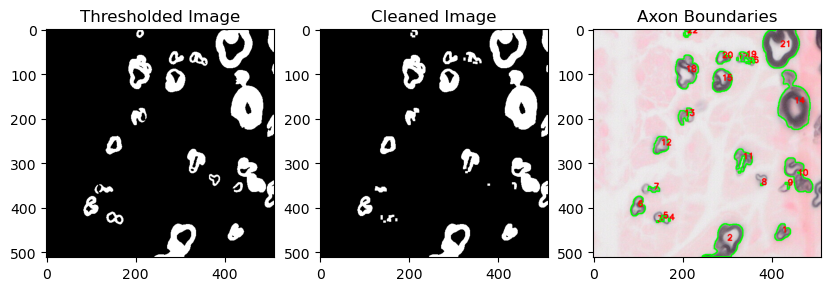

Processed systematic_patch_54.png - Axons detected: 4

Axon 1:
  Center = (22.00, 27.00)
  Outer Radius = 1.9528 µm
  Inner Radius = 1.9528 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (22.00, 27.00)
  Outer Radius = 1.1652 µm
  Inner Radius = 1.1652 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (22.00, 27.00)
  Outer Radius = 2.8934 µm
  Inner Radius = 2.8934 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (22.00, 27.00)
  Outer Radius = 2.1031 µm
  Inner Radius = 2.1031 µm
  Thickness = 0.0000 µm



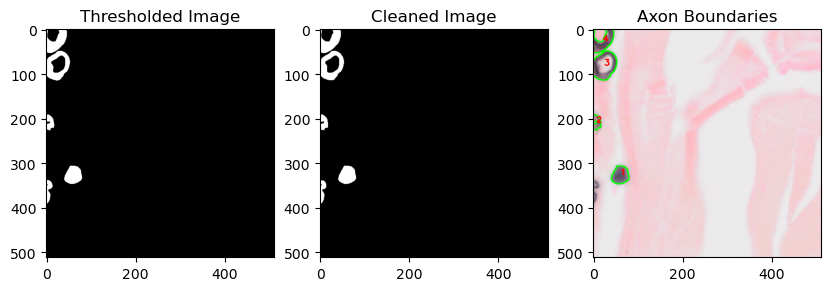

Processed systematic_patch_55.png - Axons detected: 675

Axon 1:
  Center = (46.00, 1.00)
  Outer Radius = 0.1954 µm
  Inner Radius = 0.1954 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (46.00, 1.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (46.00, 1.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (46.00, 1.00)
  Outer Radius = 0.3116 µm
  Inner Radius = 0.3116 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (46.00, 1.00)
  Outer Radius = 0.2585 µm
  Inner Radius = 0.2585 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (46.00, 1.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (46.00, 1.00)
  Outer Radius = 0.3635 µm
  Inner Radius = 0.3635 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (46.00, 1.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (46.00, 1.00)
  Outer Radius

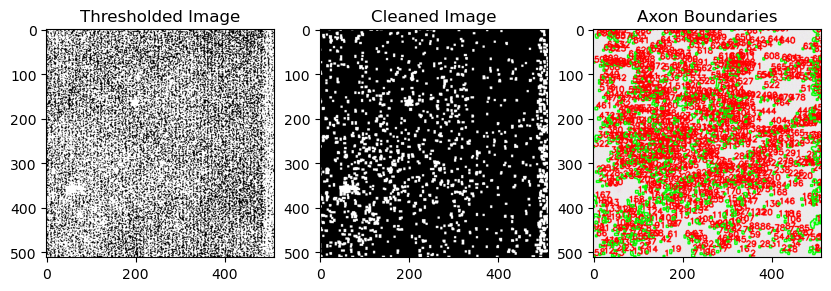

Processed systematic_patch_56.png - Axons detected: 1

Axon 1:
  Center = (500.00, 9.00)
  Outer Radius = 1.2329 µm
  Inner Radius = 1.2329 µm
  Thickness = 0.0000 µm



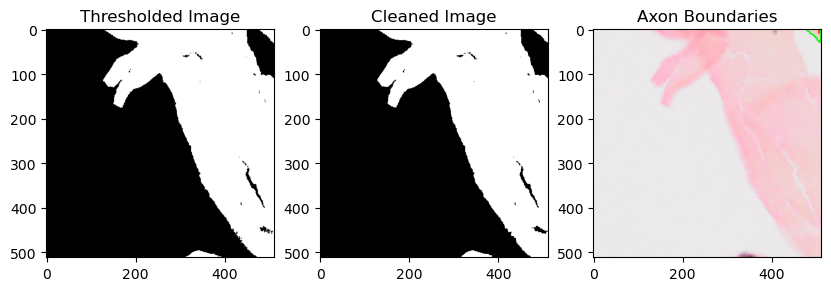

Processed systematic_patch_57.png - Axons detected: 12

Axon 1:
  Center = (310.00, 43.00)
  Outer Radius = 1.5128 µm
  Inner Radius = 1.5128 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (310.00, 43.00)
  Outer Radius = 0.2326 µm
  Inner Radius = 0.2326 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (310.00, 43.00)
  Outer Radius = 1.6741 µm
  Inner Radius = 1.6741 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (310.00, 43.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (310.00, 43.00)
  Outer Radius = 1.3291 µm
  Inner Radius = 1.3291 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (310.00, 43.00)
  Outer Radius = 1.5091 µm
  Inner Radius = 1.5091 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (310.00, 43.00)
  Outer Radius = 0.4886 µm
  Inner Radius = 0.4886 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (310.00, 43.00)
  Outer Radius = 0.5155 µm
  Inner Radius = 0.5155 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (310.00, 43.0

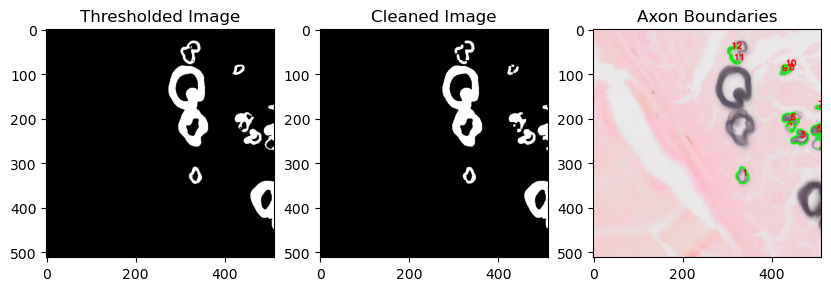

Processed systematic_patch_58.png - Axons detected: 13

Axon 1:
  Center = (31.00, 50.00)
  Outer Radius = 4.2295 µm
  Inner Radius = 4.2295 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (31.00, 50.00)
  Outer Radius = 4.9021 µm
  Inner Radius = 4.9021 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (31.00, 50.00)
  Outer Radius = 0.2985 µm
  Inner Radius = 0.2985 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (31.00, 50.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (31.00, 50.00)
  Outer Radius = 0.9666 µm
  Inner Radius = 0.9666 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (31.00, 50.00)
  Outer Radius = 0.2764 µm
  Inner Radius = 0.2764 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (31.00, 50.00)
  Outer Radius = 1.4105 µm
  Inner Radius = 1.4105 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (31.00, 50.00)
  Outer Radius = 0.7464 µm
  Inner Radius = 0.7464 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (31.00, 50.00)
  Oute

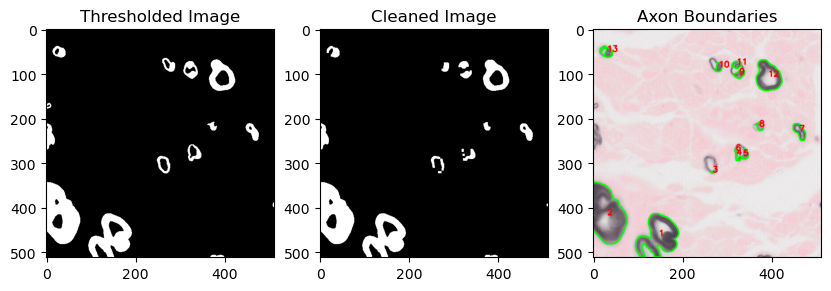

Processed systematic_patch_59.png - Axons detected: 19

Axon 1:
  Center = (487.00, 51.00)
  Outer Radius = 3.6570 µm
  Inner Radius = 3.6570 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (487.00, 51.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (487.00, 51.00)
  Outer Radius = 0.3241 µm
  Inner Radius = 0.3241 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (487.00, 51.00)
  Outer Radius = 0.3290 µm
  Inner Radius = 0.3290 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (487.00, 51.00)
  Outer Radius = 2.9530 µm
  Inner Radius = 2.9530 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (487.00, 51.00)
  Outer Radius = 0.2985 µm
  Inner Radius = 0.2985 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (487.00, 51.00)
  Outer Radius = 0.6676 µm
  Inner Radius = 0.6676 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (487.00, 51.00)
  Outer Radius = 3.6895 µm
  Inner Radius = 3.6895 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (487.00, 51.0

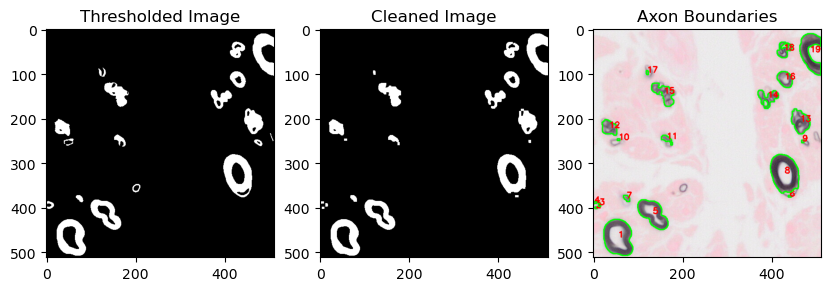

Processed systematic_patch_6.png - Axons detected: 12

Axon 1:
  Center = (83.00, 36.00)
  Outer Radius = 1.2533 µm
  Inner Radius = 1.2533 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (83.00, 36.00)
  Outer Radius = 2.1916 µm
  Inner Radius = 2.1916 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (83.00, 36.00)
  Outer Radius = 1.5757 µm
  Inner Radius = 1.5757 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (83.00, 36.00)
  Outer Radius = 1.8199 µm
  Inner Radius = 1.8199 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (83.00, 36.00)
  Outer Radius = 1.4008 µm
  Inner Radius = 1.4008 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (83.00, 36.00)
  Outer Radius = 2.3790 µm
  Inner Radius = 2.3790 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (83.00, 36.00)
  Outer Radius = 1.5762 µm
  Inner Radius = 1.5762 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (83.00, 36.00)
  Outer Radius = 0.6129 µm
  Inner Radius = 0.6129 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (83.00, 36.00)
  Outer

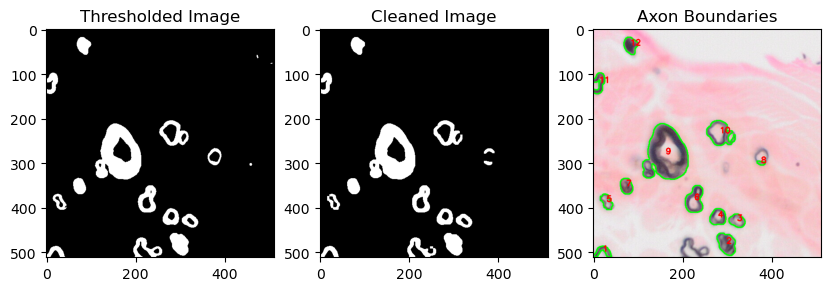

Processed systematic_patch_60.png - Axons detected: 12

Axon 1:
  Center = (138.00, 93.00)
  Outer Radius = 1.7544 µm
  Inner Radius = 1.7544 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (138.00, 93.00)
  Outer Radius = 5.0578 µm
  Inner Radius = 5.0578 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (138.00, 93.00)
  Outer Radius = 1.6126 µm
  Inner Radius = 1.6126 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (138.00, 93.00)
  Outer Radius = 2.2021 µm
  Inner Radius = 2.2021 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (138.00, 93.00)
  Outer Radius = 1.1041 µm
  Inner Radius = 1.1041 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (138.00, 93.00)
  Outer Radius = 2.4046 µm
  Inner Radius = 2.4046 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (138.00, 93.00)
  Outer Radius = 0.3192 µm
  Inner Radius = 0.3192 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (138.00, 93.00)
  Outer Radius = 0.3523 µm
  Inner Radius = 0.3523 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (138.00, 93.0

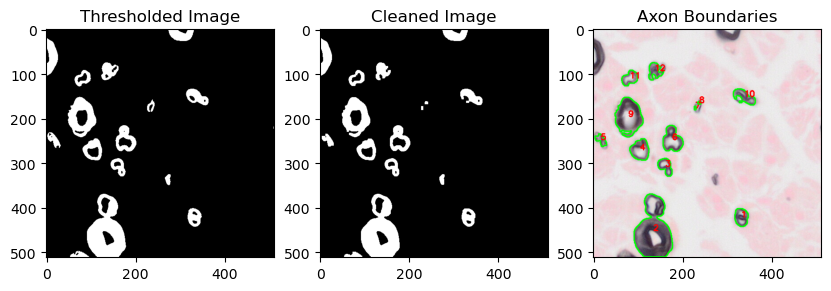

Processed systematic_patch_61.png - Axons detected: 7

Axon 1:
  Center = (484.00, 75.00)
  Outer Radius = 2.4699 µm
  Inner Radius = 2.4699 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (484.00, 75.00)
  Outer Radius = 2.8641 µm
  Inner Radius = 2.8641 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (484.00, 75.00)
  Outer Radius = 2.6267 µm
  Inner Radius = 2.6267 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (484.00, 75.00)
  Outer Radius = 1.1821 µm
  Inner Radius = 1.1821 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (484.00, 75.00)
  Outer Radius = 4.2171 µm
  Inner Radius = 4.2171 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (484.00, 75.00)
  Outer Radius = 2.5495 µm
  Inner Radius = 2.5495 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (484.00, 75.00)
  Outer Radius = 2.8384 µm
  Inner Radius = 2.8384 µm
  Thickness = 0.0000 µm



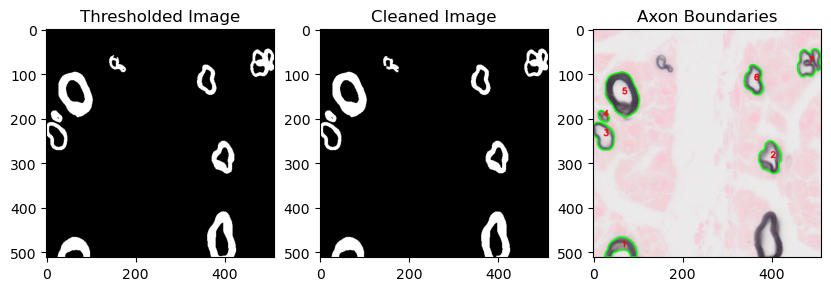

Processed systematic_patch_62.png - Axons detected: 24

Axon 1:
  Center = (244.00, 72.00)
  Outer Radius = 2.2316 µm
  Inner Radius = 2.2316 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (244.00, 72.00)
  Outer Radius = 2.9202 µm
  Inner Radius = 2.9202 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (244.00, 72.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (244.00, 72.00)
  Outer Radius = 0.2764 µm
  Inner Radius = 0.2764 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (244.00, 72.00)
  Outer Radius = 1.6439 µm
  Inner Radius = 1.6439 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (244.00, 72.00)
  Outer Radius = 1.2412 µm
  Inner Radius = 1.2412 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (244.00, 72.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (244.00, 72.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (244.00, 72.0

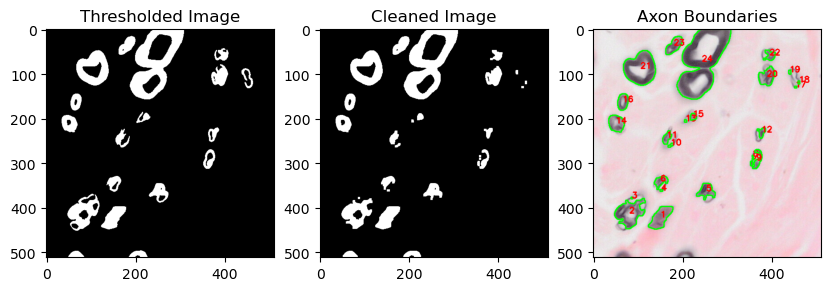

Processed systematic_patch_63.png - Axons detected: 2

Axon 1:
  Center = (430.00, 408.00)
  Outer Radius = 1.0947 µm
  Inner Radius = 1.0947 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (430.00, 408.00)
  Outer Radius = 2.5916 µm
  Inner Radius = 2.5916 µm
  Thickness = 0.0000 µm



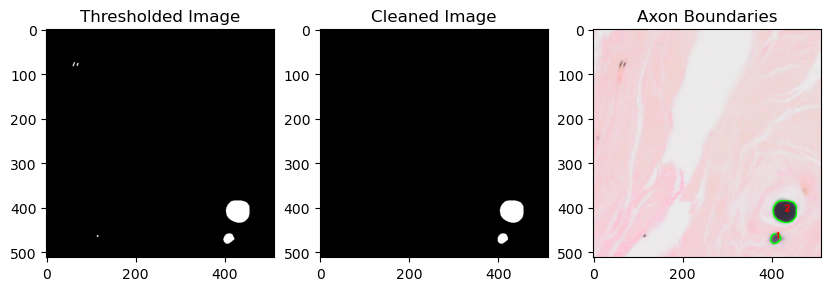

Processed systematic_patch_64.png - Axons detected: 2

Axon 1:
  Center = (23.00, 252.00)
  Outer Radius = 0.8215 µm
  Inner Radius = 0.8215 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (23.00, 252.00)
  Outer Radius = 1.4065 µm
  Inner Radius = 1.4065 µm
  Thickness = 0.0000 µm



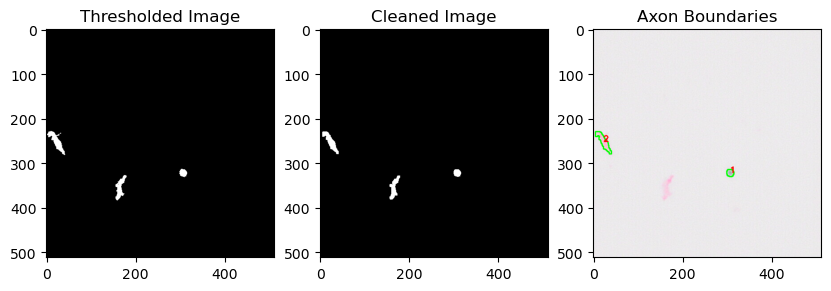

Processed systematic_patch_65.png - Axons detected: 4

Axon 1:
  Center = (354.00, 14.00)
  Outer Radius = 0.3501 µm
  Inner Radius = 0.3501 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (354.00, 14.00)
  Outer Radius = 2.0447 µm
  Inner Radius = 2.0447 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (354.00, 14.00)
  Outer Radius = 2.3686 µm
  Inner Radius = 2.3686 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (354.00, 14.00)
  Outer Radius = 2.2280 µm
  Inner Radius = 2.2280 µm
  Thickness = 0.0000 µm



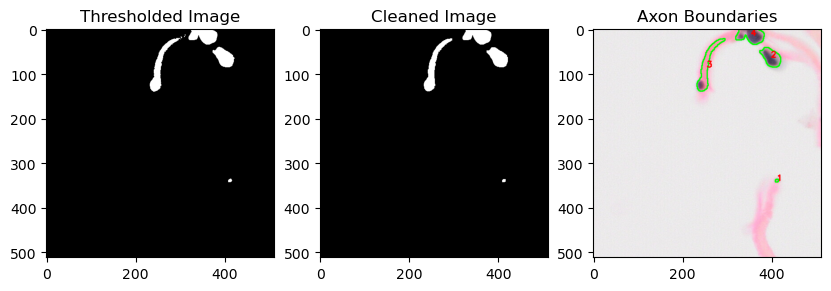

Processed systematic_patch_66.png - Axons detected: 2

Axon 1:
  Center = (478.00, 40.00)
  Outer Radius = 1.8746 µm
  Inner Radius = 1.8746 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (478.00, 40.00)
  Outer Radius = 4.2903 µm
  Inner Radius = 4.2903 µm
  Thickness = 0.0000 µm



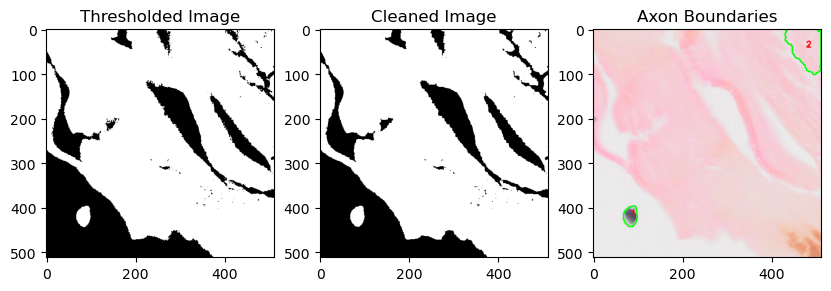

Processed systematic_patch_67.png - Axons detected: 16

Axon 1:
  Center = (130.00, 13.00)
  Outer Radius = 0.8965 µm
  Inner Radius = 0.8965 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (130.00, 13.00)
  Outer Radius = 2.2391 µm
  Inner Radius = 2.2391 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (130.00, 13.00)
  Outer Radius = 0.7999 µm
  Inner Radius = 0.7999 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (130.00, 13.00)
  Outer Radius = 4.3764 µm
  Inner Radius = 4.3764 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (130.00, 13.00)
  Outer Radius = 2.1887 µm
  Inner Radius = 2.1887 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (130.00, 13.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (130.00, 13.00)
  Outer Radius = 1.2001 µm
  Inner Radius = 1.2001 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (130.00, 13.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (130.00, 13.0

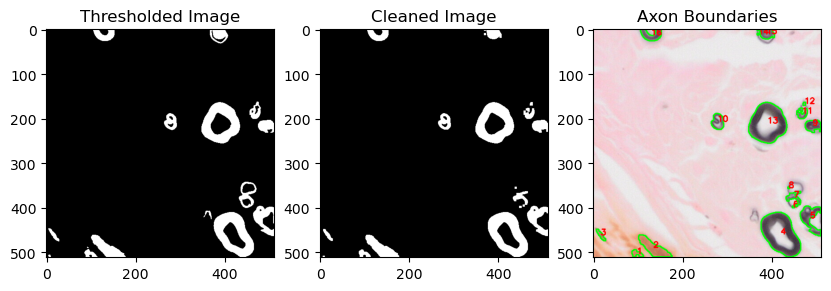

Processed systematic_patch_68.png - Axons detected: 9

Axon 1:
  Center = (338.00, 173.00)
  Outer Radius = 1.0495 µm
  Inner Radius = 1.0495 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (338.00, 173.00)
  Outer Radius = 3.5434 µm
  Inner Radius = 3.5434 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (338.00, 173.00)
  Outer Radius = 4.2194 µm
  Inner Radius = 4.2194 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (338.00, 173.00)
  Outer Radius = 1.0295 µm
  Inner Radius = 1.0295 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (338.00, 173.00)
  Outer Radius = 4.1404 µm
  Inner Radius = 4.1404 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (338.00, 173.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (338.00, 173.00)
  Outer Radius = 0.8147 µm
  Inner Radius = 0.8147 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (338.00, 173.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (338.0

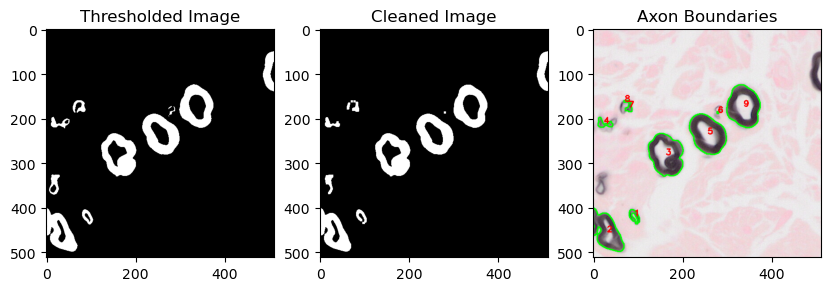

Processed systematic_patch_69.png - Axons detected: 11

Axon 1:
  Center = (84.00, 20.00)
  Outer Radius = 2.9292 µm
  Inner Radius = 2.9292 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (84.00, 20.00)
  Outer Radius = 1.2565 µm
  Inner Radius = 1.2565 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (84.00, 20.00)
  Outer Radius = 3.7026 µm
  Inner Radius = 3.7026 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (84.00, 20.00)
  Outer Radius = 4.5514 µm
  Inner Radius = 4.5514 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (84.00, 20.00)
  Outer Radius = 3.7664 µm
  Inner Radius = 3.7664 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (84.00, 20.00)
  Outer Radius = 1.5549 µm
  Inner Radius = 1.5549 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (84.00, 20.00)
  Outer Radius = 1.4456 µm
  Inner Radius = 1.4456 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (84.00, 20.00)
  Outer Radius = 1.5290 µm
  Inner Radius = 1.5290 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (84.00, 20.00)
  Oute

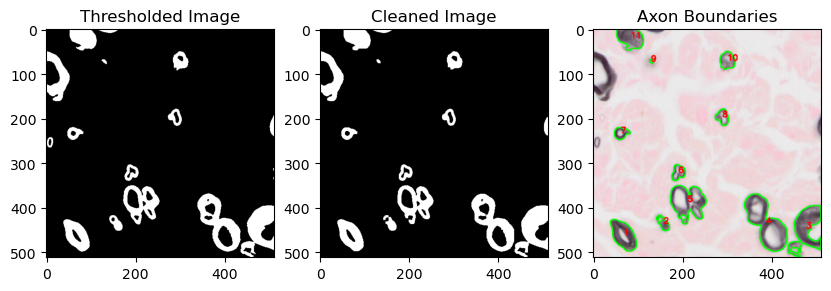

Processed systematic_patch_7.png - Axons detected: 25

Axon 1:
  Center = (414.00, 12.00)
  Outer Radius = 1.5963 µm
  Inner Radius = 1.5963 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (414.00, 12.00)
  Outer Radius = 1.4334 µm
  Inner Radius = 1.4334 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (414.00, 12.00)
  Outer Radius = 1.0021 µm
  Inner Radius = 1.0021 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (414.00, 12.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (414.00, 12.00)
  Outer Radius = 0.9861 µm
  Inner Radius = 0.9861 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (414.00, 12.00)
  Outer Radius = 2.1913 µm
  Inner Radius = 2.1913 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (414.00, 12.00)
  Outer Radius = 0.7103 µm
  Inner Radius = 0.7103 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (414.00, 12.00)
  Outer Radius = 0.7899 µm
  Inner Radius = 0.7899 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (414.00, 12.00

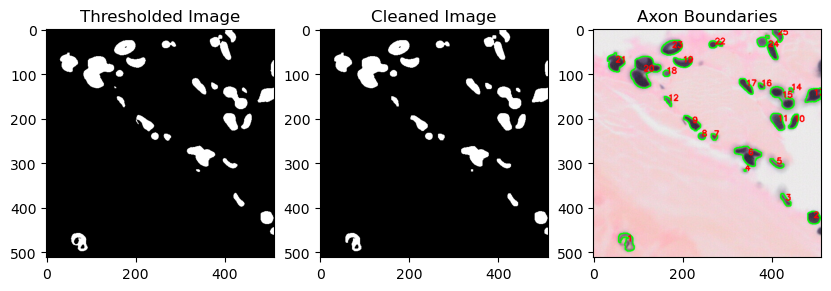

Processed systematic_patch_70.png - Axons detected: 10

Axon 1:
  Center = (70.00, 26.00)
  Outer Radius = 1.3411 µm
  Inner Radius = 1.3411 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (70.00, 26.00)
  Outer Radius = 4.3220 µm
  Inner Radius = 4.3220 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (70.00, 26.00)
  Outer Radius = 2.2911 µm
  Inner Radius = 2.2911 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (70.00, 26.00)
  Outer Radius = 0.4406 µm
  Inner Radius = 0.4406 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (70.00, 26.00)
  Outer Radius = 3.8417 µm
  Inner Radius = 3.8417 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (70.00, 26.00)
  Outer Radius = 0.4370 µm
  Inner Radius = 0.4370 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (70.00, 26.00)
  Outer Radius = 4.4886 µm
  Inner Radius = 4.4886 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (70.00, 26.00)
  Outer Radius = 1.9847 µm
  Inner Radius = 1.9847 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (70.00, 26.00)
  Oute

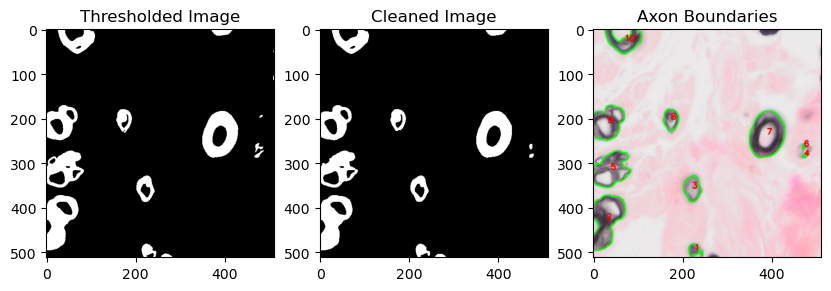

Processed systematic_patch_71.png - Axons detected: 7

Axon 1:
  Center = (68.00, 19.00)
  Outer Radius = 1.4472 µm
  Inner Radius = 1.4472 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (68.00, 19.00)
  Outer Radius = 2.3970 µm
  Inner Radius = 2.3970 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (68.00, 19.00)
  Outer Radius = 2.0373 µm
  Inner Radius = 2.0373 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (68.00, 19.00)
  Outer Radius = 2.3121 µm
  Inner Radius = 2.3121 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (68.00, 19.00)
  Outer Radius = 2.3504 µm
  Inner Radius = 2.3504 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (68.00, 19.00)
  Outer Radius = 2.0428 µm
  Inner Radius = 2.0428 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (68.00, 19.00)
  Outer Radius = 2.2613 µm
  Inner Radius = 2.2613 µm
  Thickness = 0.0000 µm



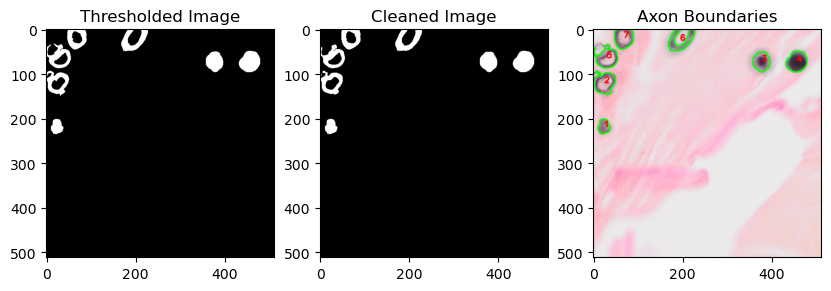

Processed systematic_patch_72.png - Axons detected: 2

Axon 1:
  Center = (80.00, 167.00)
  Outer Radius = 1.1968 µm
  Inner Radius = 1.1968 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (80.00, 167.00)
  Outer Radius = 2.2585 µm
  Inner Radius = 2.2585 µm
  Thickness = 0.0000 µm



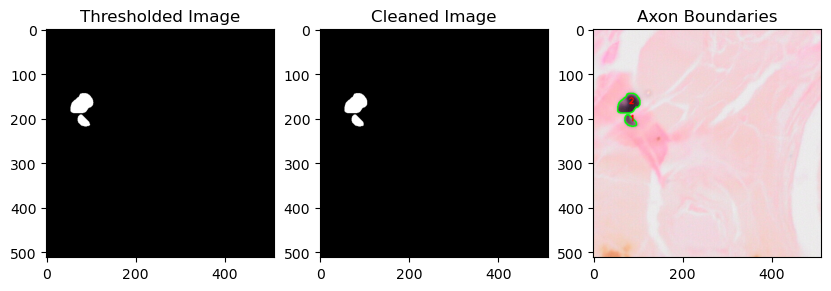

Processed systematic_patch_73.png - Axons detected: 23

Axon 1:
  Center = (503.00, 101.00)
  Outer Radius = 0.1954 µm
  Inner Radius = 0.1954 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (503.00, 101.00)
  Outer Radius = 0.1954 µm
  Inner Radius = 0.1954 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (503.00, 101.00)
  Outer Radius = 0.3064 µm
  Inner Radius = 0.3064 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (503.00, 101.00)
  Outer Radius = 0.3385 µm
  Inner Radius = 0.3385 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (503.00, 101.00)
  Outer Radius = 0.3969 µm
  Inner Radius = 0.3969 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (503.00, 101.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (503.00, 101.00)
  Outer Radius = 0.2523 µm
  Inner Radius = 0.2523 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (503.00, 101.00)
  Outer Radius = 0.2257 µm
  Inner Radius = 0.2257 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (503.

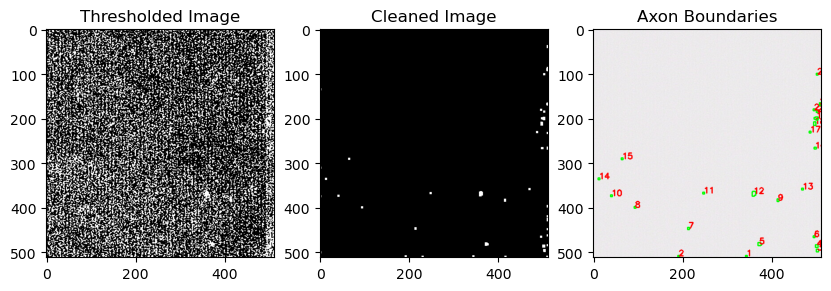

Processed systematic_patch_74.png - Axons detected: 2

Axon 1:
  Center = (454.00, 76.00)
  Outer Radius = 1.2970 µm
  Inner Radius = 1.2970 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (454.00, 76.00)
  Outer Radius = 6.0474 µm
  Inner Radius = 6.0474 µm
  Thickness = 0.0000 µm



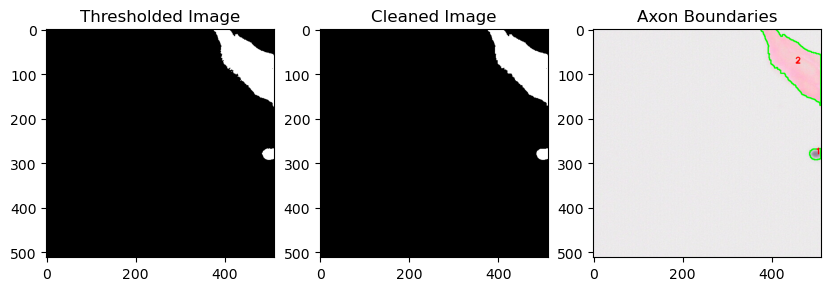

Processed systematic_patch_75.png - Axons detected: 7

Axon 1:
  Center = (57.00, 131.00)
  Outer Radius = 2.8147 µm
  Inner Radius = 2.8147 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (57.00, 131.00)
  Outer Radius = 0.8349 µm
  Inner Radius = 0.8349 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (57.00, 131.00)
  Outer Radius = 1.9995 µm
  Inner Radius = 1.9995 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (57.00, 131.00)
  Outer Radius = 0.7858 µm
  Inner Radius = 0.7858 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (57.00, 131.00)
  Outer Radius = 1.4996 µm
  Inner Radius = 1.4996 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (57.00, 131.00)
  Outer Radius = 2.4469 µm
  Inner Radius = 2.4469 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (57.00, 131.00)
  Outer Radius = 0.3888 µm
  Inner Radius = 0.3888 µm
  Thickness = 0.0000 µm



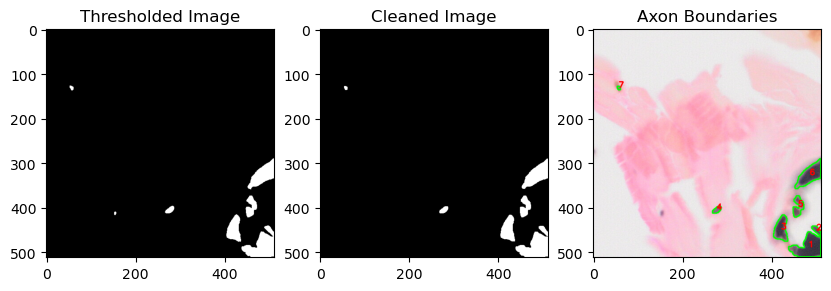

Processed systematic_patch_76.png - Axons detected: 9

Axon 1:
  Center = (96.00, 1.00)
  Outer Radius = 2.3001 µm
  Inner Radius = 2.3001 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (96.00, 1.00)
  Outer Radius = 7.9398 µm
  Inner Radius = 7.9398 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (96.00, 1.00)
  Outer Radius = 0.4352 µm
  Inner Radius = 0.4352 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (96.00, 1.00)
  Outer Radius = 0.8921 µm
  Inner Radius = 0.8921 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (96.00, 1.00)
  Outer Radius = 0.4935 µm
  Inner Radius = 0.4935 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (96.00, 1.00)
  Outer Radius = 0.4754 µm
  Inner Radius = 0.4754 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (96.00, 1.00)
  Outer Radius = 0.5740 µm
  Inner Radius = 0.5740 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (96.00, 1.00)
  Outer Radius = 1.4620 µm
  Inner Radius = 1.4620 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (96.00, 1.00)
  Outer Radius =

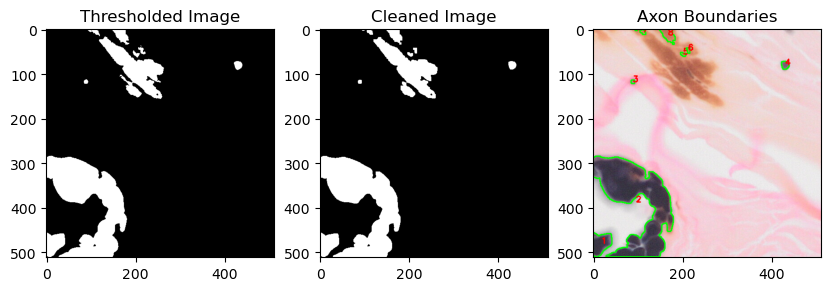

Processed systematic_patch_77.png - Axons detected: 10

Axon 1:
  Center = (135.00, 15.00)
  Outer Radius = 0.8048 µm
  Inner Radius = 0.8048 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (135.00, 15.00)
  Outer Radius = 3.6668 µm
  Inner Radius = 3.6668 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (135.00, 15.00)
  Outer Radius = 0.3141 µm
  Inner Radius = 0.3141 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (135.00, 15.00)
  Outer Radius = 0.2764 µm
  Inner Radius = 0.2764 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (135.00, 15.00)
  Outer Radius = 0.5397 µm
  Inner Radius = 0.5397 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (135.00, 15.00)
  Outer Radius = 0.6567 µm
  Inner Radius = 0.6567 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (135.00, 15.00)
  Outer Radius = 1.0411 µm
  Inner Radius = 1.0411 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (135.00, 15.00)
  Outer Radius = 0.9877 µm
  Inner Radius = 0.9877 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (135.00, 15.0

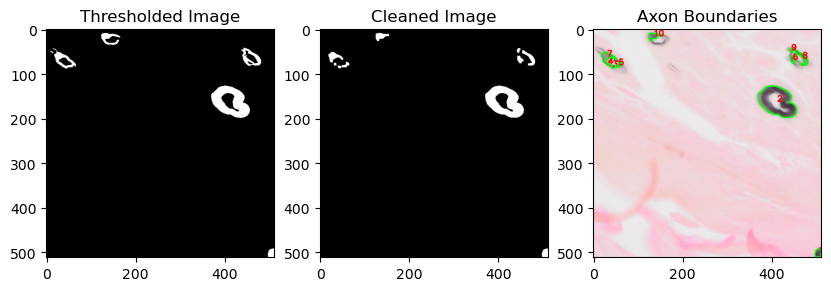

Processed systematic_patch_78.png - Axons detected: 10

Axon 1:
  Center = (178.00, 33.00)
  Outer Radius = 0.5232 µm
  Inner Radius = 0.5232 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (178.00, 33.00)
  Outer Radius = 3.5441 µm
  Inner Radius = 3.5441 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (178.00, 33.00)
  Outer Radius = 3.3551 µm
  Inner Radius = 3.3551 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (178.00, 33.00)
  Outer Radius = 1.7440 µm
  Inner Radius = 1.7440 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (178.00, 33.00)
  Outer Radius = 0.6358 µm
  Inner Radius = 0.6358 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (178.00, 33.00)
  Outer Radius = 0.9624 µm
  Inner Radius = 0.9624 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (178.00, 33.00)
  Outer Radius = 1.4008 µm
  Inner Radius = 1.4008 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (178.00, 33.00)
  Outer Radius = 1.3611 µm
  Inner Radius = 1.3611 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (178.00, 33.0

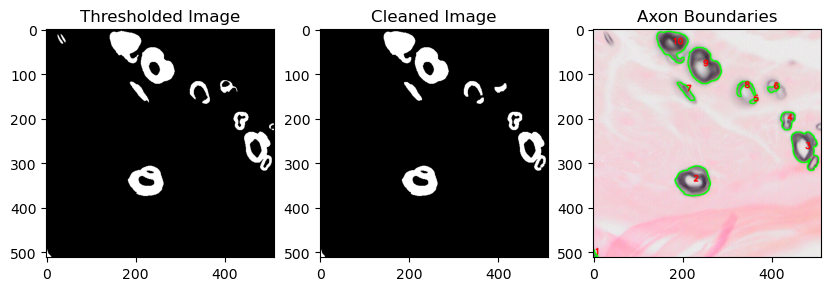

Processed systematic_patch_79.png - Axons detected: 5

Axon 1:
  Center = (277.00, 31.00)
  Outer Radius = 3.5116 µm
  Inner Radius = 3.5116 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (277.00, 31.00)
  Outer Radius = 0.6257 µm
  Inner Radius = 0.6257 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (277.00, 31.00)
  Outer Radius = 1.4593 µm
  Inner Radius = 1.4593 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (277.00, 31.00)
  Outer Radius = 1.3381 µm
  Inner Radius = 1.3381 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (277.00, 31.00)
  Outer Radius = 2.7706 µm
  Inner Radius = 2.7706 µm
  Thickness = 0.0000 µm



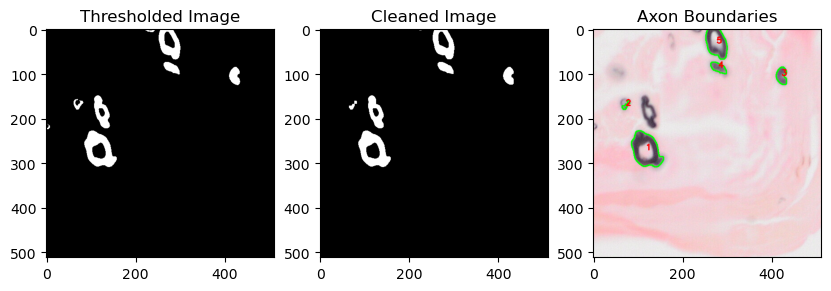

Processed systematic_patch_8.png - Axons detected: 39

Axon 1:
  Center = (261.00, 9.00)
  Outer Radius = 1.0764 µm
  Inner Radius = 1.0764 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (261.00, 9.00)
  Outer Radius = 1.3826 µm
  Inner Radius = 1.3826 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (261.00, 9.00)
  Outer Radius = 2.6613 µm
  Inner Radius = 2.6613 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (261.00, 9.00)
  Outer Radius = 1.3646 µm
  Inner Radius = 1.3646 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (261.00, 9.00)
  Outer Radius = 0.6090 µm
  Inner Radius = 0.6090 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (261.00, 9.00)
  Outer Radius = 1.0061 µm
  Inner Radius = 1.0061 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (261.00, 9.00)
  Outer Radius = 0.6050 µm
  Inner Radius = 0.6050 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (261.00, 9.00)
  Outer Radius = 0.7324 µm
  Inner Radius = 0.7324 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (261.00, 9.00)
  Outer

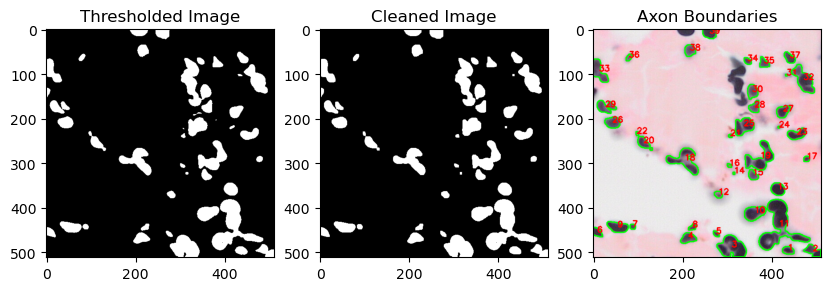

Processed systematic_patch_80.png - Axons detected: 3

Axon 1:
  Center = (311.00, 97.00)
  Outer Radius = 1.4959 µm
  Inner Radius = 1.4959 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (311.00, 97.00)
  Outer Radius = 2.9085 µm
  Inner Radius = 2.9085 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (311.00, 97.00)
  Outer Radius = 1.4284 µm
  Inner Radius = 1.4284 µm
  Thickness = 0.0000 µm



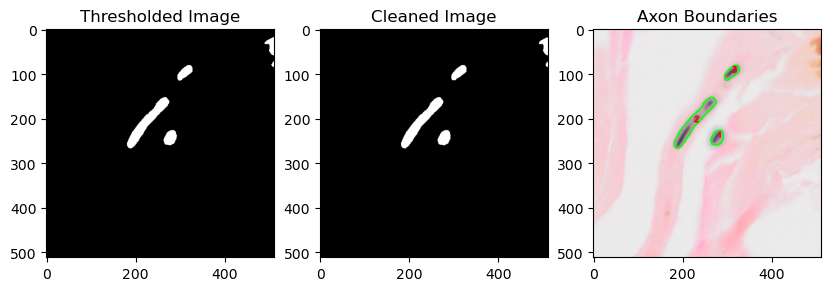

Processed systematic_patch_81.png - Axons detected: 7

Axon 1:
  Center = (367.00, 8.00)
  Outer Radius = 0.8234 µm
  Inner Radius = 0.8234 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (367.00, 8.00)
  Outer Radius = 1.7567 µm
  Inner Radius = 1.7567 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (367.00, 8.00)
  Outer Radius = 1.5290 µm
  Inner Radius = 1.5290 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (367.00, 8.00)
  Outer Radius = 1.6593 µm
  Inner Radius = 1.6593 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (367.00, 8.00)
  Outer Radius = 1.0675 µm
  Inner Radius = 1.0675 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (367.00, 8.00)
  Outer Radius = 1.6512 µm
  Inner Radius = 1.6512 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (367.00, 8.00)
  Outer Radius = 0.5426 µm
  Inner Radius = 0.5426 µm
  Thickness = 0.0000 µm



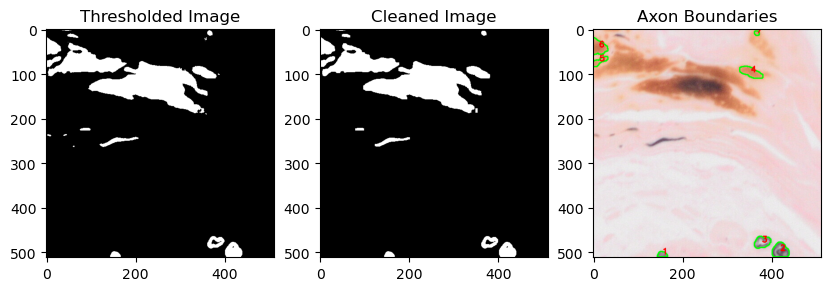

Processed systematic_patch_9.png - Axons detected: 37

Axon 1:
  Center = (137.00, 15.00)
  Outer Radius = 1.2716 µm
  Inner Radius = 1.2716 µm
  Thickness = 0.0000 µm

Axon 2:
  Center = (137.00, 15.00)
  Outer Radius = 1.8657 µm
  Inner Radius = 1.8657 µm
  Thickness = 0.0000 µm

Axon 3:
  Center = (137.00, 15.00)
  Outer Radius = 1.7178 µm
  Inner Radius = 1.7178 µm
  Thickness = 0.0000 µm

Axon 4:
  Center = (137.00, 15.00)
  Outer Radius = 1.7881 µm
  Inner Radius = 1.7881 µm
  Thickness = 0.0000 µm

Axon 5:
  Center = (137.00, 15.00)
  Outer Radius = 0.3613 µm
  Inner Radius = 0.3613 µm
  Thickness = 0.0000 µm

Axon 6:
  Center = (137.00, 15.00)
  Outer Radius = 0.3290 µm
  Inner Radius = 0.3290 µm
  Thickness = 0.0000 µm

Axon 7:
  Center = (137.00, 15.00)
  Outer Radius = 2.4696 µm
  Inner Radius = 2.4696 µm
  Thickness = 0.0000 µm

Axon 8:
  Center = (137.00, 15.00)
  Outer Radius = 5.4880 µm
  Inner Radius = 5.4880 µm
  Thickness = 0.0000 µm

Axon 9:
  Center = (137.00, 15.00

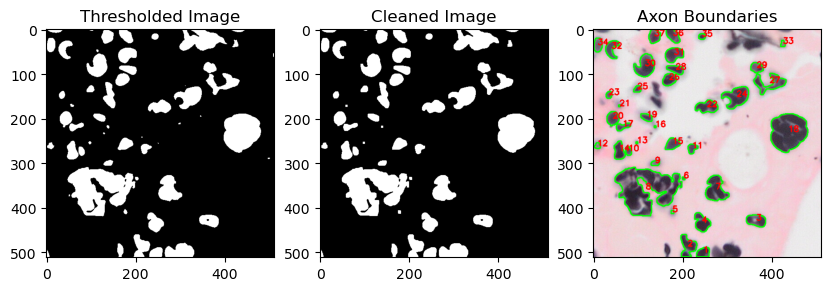


Processing complete! Processed images saved in C:\Users\sanje\Downloads\axon_output35


In [24]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Path to the folder containing images
input_folder = r'C:\Users\sanje\Downloads\patches'  # Change this to your actual folder path
output_folder = r"C:\Users\sanje\Downloads\axon_output35"

# Create output folder if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Function to process each image
def process_image(image_path, output_path):
    # Load the image
    image = cv2.imread(image_path, cv2.IMREAD_COLOR)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (3, 3), 0)
    
    # Apply Otsu's thresholding
    _, thresh = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    
    # Morphological operations to clean up noise
    kernel = np.ones((3,3), np.uint8)
    cleaned = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)
    
    # Find contours
    contours, _ = cv2.findContours(cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Data storage
    axon_data = []
    filtered_contours = []

    for cnt in contours:
        area = cv2.contourArea(cnt)
        perimeter = cv2.arcLength(cnt, True)
        x, y, w, h = cv2.boundingRect(cnt)
        aspect_ratio = float(w) / h  # Shape elongation check

        if 10 < area < 50000:  # Adjust area range for axon detection
            circularity = 4 * np.pi * (area / (perimeter * perimeter + 1e-5))
            
            # Filter based on circularity, aspect ratio, and holes (axon rings)
            if 0.2 < circularity < 1.3 and 0.5 < aspect_ratio < 2.0:
                # Check if contour has holes (axon myelin rings)
                mask = np.zeros_like(gray)
                cv2.drawContours(mask, [cnt], -1, 255, thickness=cv2.FILLED)
                mask_inv = cv2.bitwise_not(mask)
                holes = cv2.countNonZero(mask_inv) - cv2.countNonZero(cleaned)

                if holes > 0:  # Ensure it has a hollow center
                    filtered_contours.append(cnt)

                    # Compute equivalent diameter (axon radius)
                    equivalent_diameter = np.sqrt(4 * area / np.pi)
                    axon_radius = equivalent_diameter / 2
                    
                    # Find the inner lumen (axon core) by thresholding inside the axon ring
                    axon_mask = np.zeros_like(gray)
                    cv2.drawContours(axon_mask, [cnt], -1, 255, thickness=cv2.FILLED)
                    inner_thresh = cv2.bitwise_and(thresh, thresh, mask=axon_mask)
                    inner_contours, _ = cv2.findContours(inner_thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

                    inner_radius = 0
                    if inner_contours:
                        largest_inner = max(inner_contours, key=cv2.contourArea)
                        inner_area = cv2.contourArea(largest_inner)
                        inner_diameter = np.sqrt(4 * inner_area / np.pi)
                        inner_radius = inner_diameter / 2

                    # Compute axon thickness
                    myelin_thickness = axon_radius - inner_radius

                    # Store data
                    axon_data.append((cnt, axon_radius, myelin_thickness))

    # Draw filtered contours and label them
    output = image.copy()

    for i, (cnt, radius, thickness) in enumerate(axon_data):
        # Compute the center of the axon
        M = cv2.moments(cnt)
        if M["m00"] != 0:
            cx = int(M["m10"] / M["m00"])
            cy = int(M["m01"] / M["m00"])
        else:
            cx, cy = 0, 0  # Default in case of error

        # Draw contour in green
        cv2.drawContours(output, [cnt], -1, (0, 255, 0), 2)

        # Label the axon number in red
        cv2.putText(output, str(i + 1), (cx, cy), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 0, 255), 2)

    # Save the output image
    cv2.imwrite(output_path, output)

    # Print number of axons detected
    print(f"Processed {os.path.basename(image_path)} - Axons detected: {len(axon_data)}\n")

    # Print formatted results
    pixel_to_micron = 0.1  # Adjust conversion factor as needed
    for i, (_, radius, thickness) in enumerate(axon_data):
        outer_radius_micron = radius * pixel_to_micron
        inner_radius_micron = (radius - thickness) * pixel_to_micron
        thickness_micron = thickness * pixel_to_micron

        print(f"Axon {i+1}:")
        print(f"  Center = ({cx:.2f}, {cy:.2f})")
        print(f"  Outer Radius = {outer_radius_micron:.4f} µm")
        print(f"  Inner Radius = {inner_radius_micron:.4f} µm")
        print(f"  Thickness = {thickness_micron:.4f} µm\n")

    # Show images (optional, uncomment if running locally)
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 3, 1)
    plt.title("Thresholded Image")
    plt.imshow(thresh, cmap="gray")

    plt.subplot(1, 3, 2)
    plt.title("Cleaned Image")
    plt.imshow(cleaned, cmap="gray")

    plt.subplot(1, 3, 3)
    plt.title("Axon Boundaries")
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))

    plt.show()

# Process all images in the folder
for filename in os.listdir(input_folder):
    if filename.lower().endswith((".png", ".jpg", ".jpeg")):
        image_path = os.path.join(input_folder, filename)
        output_path = os.path.join(output_folder, f"processed_{filename}")
        process_image(image_path, output_path)

print(f"\nProcessing complete! Processed images saved in {output_folder}")
